# Figures

In [4]:
%load_ext autoreload
%autoreload 2

In [5]:
import pandas as pd

from math import floor

import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt

import plotly.express as px
from plotly import colors

sns.set_theme(style="ticks")

from colour import Color
import itertools

import plotly.graph_objects as go
from plotly.subplots import make_subplots

from math import exp, log, log10

import pickle

# from polygenic_plots.plots import compare_strategies_single_run
from polymodel.config import Config

from polymodel.params import PARAMS

from polymodel.run import (
    # variable_strategy_run,
    multiple_run,
    mutual_protection_run,
    simulations_run,
)

from polymodel.utils import (
    Fungicide,
    find_beta_vectorised,
    truncated_exp_pdf,
    logit10_vectorised,
    initial_point_distribution,
    trait_vec
)

# from polymodel.fitting import HostObjective

from polymodel.simulator import Simulator

from polymodel.consts import (
    DEFAULT_I0, 
    DEFAULT_BETA,
    MUTATION_PROP,
    FUNG_MUTATION_SCALE,
    HOST_MUTATION_SCALE,
    DEFAULT_P,
    TRAIN_TEST_SPLIT_PROPORTION
)

from plots.plots import (
    within_season, 
    compare_strategies_overview,
    compare_strategies_overview_2,
    dist_plot,
)



from plots.consts import (FILL_OPACITY, FUNG_COLOUR, GREY_LABEL, HOST_COLOUR,
                          KEY_ATTRS, KEY_TO_LONGNAME, KEY_TO_SHORTNAME,
                          MARKER_COLOURS, PERCENTILES, TRAIT_FULLNAME,
                          TYPE_PLOT_MAP, Y_LABEL_MAP)

from plots.fns import (
    dist_means_as_df, 
    generate_dist_mean,
    generate_dist_var,
    generate_dists,
    get_arrow_annotation,
    get_dist_traces,
    get_text_annotation,
    mutual_difference_traces,
    standard_layout,
    traces_with_uncertainty,
    traces_with_uncertainty_bands, 
    hex_to_rgb
)

In [6]:
COLZ = sns.color_palette('muted').as_hex()

# Fig 1 - the model

In [4]:
cf1 = Config(
    'single',
    sprays=[2],
    host_on = [False],
    n_years=1,
    mutation_proportion=MUTATION_PROP,
    mutation_scale_fung=DEFAULT_P * FUNG_MUTATION_SCALE,
    mutation_scale_host=DEFAULT_P * HOST_MUTATION_SCALE,
)

CONFIG
------
I0_single = 0.0098570319660089
beta_single = 0.0078954305108593
cultivar = Mariboss
host_growth = True
host_on = False
k_b = 0.7310132149416496
k_mu = 10.42015277772923
l_b = 6.519374951898358
l_mu = 0.8089142283850663
mutation_on = True
mutation_proportion = 1.234375e-05
mutation_scale_fung = 0.00191996039181228
mutation_scale_host = 0.00191996039181228
n_iterations = None
n_k = 50
n_l = 50
n_years = 1
replace_cultivars = None
sprays = 2
type = single



In [5]:
def severity_for_curvature(curvature, conf):
    NOT_USED_NUM = 0.5

    sim_on = Simulator(
        host_plant_on=False,
        fungicide_on=True,
        number_of_sprays=2,
        l_mu=NOT_USED_NUM,
        l_b=NOT_USED_NUM,
        k_mu=NOT_USED_NUM,
        k_b=NOT_USED_NUM,
        config=conf
    )

    sim_on.initial_k_dist = initial_point_distribution(
        conf.n_k,
        curvature,
    )

    output_trait_on = (
        sim_on
        .run_model(
            I0_vec=[DEFAULT_I0],
            beta_vec=[DEFAULT_BETA]
        )
    )
    
    t = output_trait_on['t']
    
    sev = 100*output_trait_on['total_I'][:, 0]
    
    return t, sev

In [6]:
def severity_for_beta(beta, curvature, conf):
    NOT_USED_NUM = 0.5

    sim_on = Simulator(
        host_plant_on=False,
        fungicide_on=True,
        number_of_sprays=2,
        l_mu=NOT_USED_NUM,
        l_b=NOT_USED_NUM,
        k_mu=NOT_USED_NUM,
        k_b=NOT_USED_NUM,
        config=conf
    )

    sim_on.initial_k_dist = initial_point_distribution(
        conf.n_k,
        curvature,
    )

    output_trait_on = (
        sim_on
        .run_model(
            I0_vec=[DEFAULT_I0],
            beta_vec=[beta]
        )
    )
    
    t = output_trait_on['t']
    
    sev = 100*output_trait_on['total_I'][:, 0]
    
    return t, sev

In [7]:
t, sev1 = severity_for_curvature(0.01, cf1)
t, sev2 = severity_for_curvature(0.8, cf1)

In [8]:
b1 = 0.0055

In [9]:
b2 = 0.009

In [10]:
t, sevb1 = severity_for_beta(b1, 0.4, cf1)
t, sevb2 = severity_for_beta(b2, 0.4, cf1)

In [11]:
fungicide = Fungicide(2)

In [12]:
fung_strain_1 = 0.01
inf_rate_1 = [fungicide.effect(fung_strain_1, tt) for tt in t]

fung_strain_2 = 0.8
inf_rate_2 = [fungicide.effect(fung_strain_2, tt) for tt in t]

In [13]:
def within_season_fig(
    sev1,
    sev2,
    sevb1,
    sevb2,
    t,
    inf_rate_1,
    inf_rate_2
):

    T2 = PARAMS.T_2
    T3 = PARAMS.T_3

    fig = make_subplots(
        rows=2,
        cols=2,
        shared_xaxes=True,
        horizontal_spacing=0.33,
    )

    col1 = 'crimson'
    col2 = 'black'

    ###
    traces = []
    shapez = []
    annotz = []
    ###

    # ROW 1 COL 1

    traces = [
        go.Scatter(
            x=t,
            y=sev1,
            mode='lines',
            name='curv1',
            line={'color': col1, 'dash': 'dash'},
            showlegend=False,
        ),
        go.Scatter(
            x=t,
            y=sev2,
            mode='lines',
            name='curv2',
            line={'color': col2},
            showlegend=False,
        )
    ]

    timing_lines = [
        go.Scatter(
            x=[T2, T2],
            y=[-0.1, 12.1],
            mode='lines',
            line={'color': 'rgba(0,0,255,0.5)', 'dash': 'dot'},
            showlegend=False,
        ),
        go.Scatter(
            x=[T3, T3],
            y=[-0.1, 12.1],
            mode='lines',
            line={'color': 'rgba(0,0,255,0.5)', 'dash': 'dot'},
            showlegend=False,
        )
    ]
    
    fig.add_traces(traces, rows=1, cols=1)
    fig.add_traces(timing_lines, rows=1, cols=1)


    #
    #
    # Row 1 col 2
    for line in traces:
        line_new = line
        line_new['y'] = [log10(0.01*ii/(1 - 0.01*ii)) for ii in line['y']]

        line_new['showlegend'] = False

        fig.add_trace(line_new, row=1, col=2)

        y_text = [10**(-5)*5]
        for ii in [-4, -3, -2, -1]:
            y_text.append(10**(ii)*1)

        y_vals = [log10(y/(1-y)) for y in y_text]

        
        
    timing_lines_logit = [
        go.Scatter(
            x=[T2, T2],
            y=[-5, 1],
            mode='lines',
            line={'color': 'rgba(0,0,255,0.5)', 'dash': 'dot'},
            showlegend=False,
        ),
        go.Scatter(
            x=[T3, T3],
            y=[-5, 1],
            mode='lines',
            line={'color': 'rgba(0,0,255,0.5)', 'dash': 'dot'},
            showlegend=False,
        )
    ]

    fig.add_traces(timing_lines_logit, rows=1, cols=2)

    
    
    #
    #
    # Row 2 col 1
    IR_traces = [
        go.Scatter(
            x=t,
            y=inf_rate_1,
            mode='lines',
            name='IR 1',
            line={'color': col1, 'dash': 'dash'},
            showlegend=False,
        ),
        go.Scatter(
            x=t,
            y=inf_rate_2,
            mode='lines',
            name='IR 2',
            line={'color': col2},
            showlegend=False,
        )
    ]

    fig.add_traces(IR_traces, rows=2, cols=1)
    fig.add_traces(timing_lines, rows=2, cols=1)
    
    
    #
    #
    # Row 2 col 2
    traces_b = [
        go.Scatter(
            x=t,
            y=sevb1,
            mode='lines',
            name='curv1',
            line={'color': COLZ[0], 'dash': 'dash'},
            showlegend=False,
        ),
        go.Scatter(
            x=t,
            y=sevb2,
            mode='lines',
            name='curv2',
            line={'color': COLZ[1]},
            showlegend=False,
        )
    ]
    
    timing_lines_b = [
        go.Scatter(
            x=[T2, T2],
            y=[-0.1, 25],
            mode='lines',
            line={'color': 'rgba(0,0,255,0.5)', 'dash': 'dot'},
            showlegend=False,
        ),
        go.Scatter(
            x=[T3, T3],
            y=[-0.1, 25],
            mode='lines',
            line={'color': 'rgba(0,0,255,0.5)', 'dash': 'dot'},
            showlegend=False,
        )
    ]
    
    fig.add_traces(traces_b, rows=2, cols=2)
    fig.add_traces(timing_lines_b, rows=2, cols=2)

    #
    #
    # LAYOUT

    fig.update_layout(standard_layout(True, height=750))
    fig.update_layout(font=dict(size=14))

    #
    #
    # ANNOTATIONS

    for text, pos in zip(
        ['Start of season', 'End of season'],
        [-0.1, 1.1]
    ):
        annotz.append(dict(
            x=pos,
            y=-0.25,
            text=text,
            showarrow=False,
            font=dict(
                color=GREY_LABEL
            ),
            xref='paper',
            yref='paper',
        ))

    a_x1 = 0
    a_x2 = 0.33
    a_y = 0.55
    
    row1 = 1.06
    row2 = 0.48
    
    col1 = -0.01
    col2 = 0.62

    annotz += [
        get_text_annotation(a_x1, a_y, 'Start of<br>season'),
        get_text_annotation(a_x2, a_y, 'End of<br>season'),
        
        get_text_annotation(col1, row1, 'A', size=20),
        get_text_annotation(col1, row2, 'C', size=20),
        get_text_annotation(col2, row1, 'B', size=20),
        get_text_annotation(col2, row2, 'D', size=20),
        
    ]

    fig.update_layout(
        shapes=shapez,
        annotations=annotz,
    )

    #
    #
    # AXES

    # X
    fig.update_xaxes(title_text='Time (degree-days)',
                     row=2, col=1,
                     showgrid=False)

    fig.update_xaxes(title_text='Time (degree-days)',
                     row=2, col=2,
                     showgrid=False)

    # Y
    fig.update_yaxes(title_text='Disease severity (%)',
                     row=1, col=1,
                     # range=[-0.03, 0.42],
                     showgrid=False)

    fig.update_yaxes(title_text='Disease severity<br>(proportion, logit scale)',
                     row=1, col=2,
                     range=[log10(yy/(1-yy)) for yy in [5e-5, 1e-1]],
                     tickvals=y_vals,
                     ticktext=y_text,
                     showgrid=False)

    fig.update_yaxes(title_text='Relative infection rate',
                     row=2, col=1,
                     range=[-0.05, 1.05],
                     showgrid=False)
    
    fig.update_yaxes(title_text='Disease severity (%)',
                     row=2, col=2,
                     showgrid=False)

    return fig

## FIG

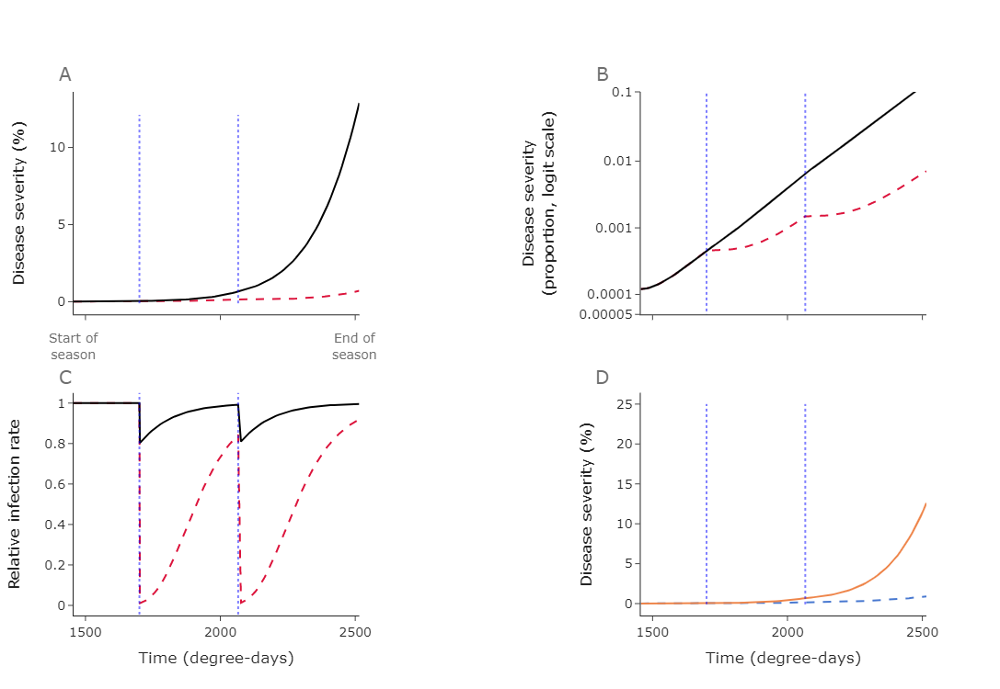

In [14]:
fig = within_season_fig(
    sev1,
    sev2,
    sevb1,
    sevb2,
    t,
    inf_rate_1,
    inf_rate_2
)

fig.show()

In [15]:
fig.write_image('../figures/paper_figs/fig1_draft.png')

# Fig 2 - model fitting

## stb

In [16]:
filename = '../data/03_model_inputs/lambda_fitted.csv'

lambda_use = float(pd.read_csv(filename).iloc[:, 1])
lambda_use

0.0328774362127231

In [17]:
sev_x = np.linspace(-0.5,100.5,301)
severity_pdf = [truncated_exp_pdf(ii, lambda_use) for ii in sev_x]

In [18]:
stb_values = pd.read_csv('../data/03_model_inputs/stb_vals.csv')

## beta

In [19]:
beta_hist = pd.read_csv('../data/03_model_inputs/beta_from_data_not_sampled_dist.csv').betas

In [20]:
beta_values = pd.read_csv('../data/03_model_inputs/beta_sampled.csv')
beta_median = beta_values.median()
beta_vals = beta_values.loc[lambda df: df.beta>1e-5].beta

In [21]:
bds = logit10_vectorised(0.01*np.array([0.04,99.5]))

In [22]:
yy = np.linspace(bds[0], bds[1], 50)

x_logit = 100 * 10**(yy)/(1+10**(yy))

In [23]:
beta_xs = find_beta_vectorised(
    0.01*x_logit,
    DEFAULT_I0
)

In [24]:
gdt = np.gradient(x_logit, beta_xs)

In [25]:
sev_pdf = [truncated_exp_pdf(ii, lambda_use) for ii in x_logit]

In [26]:
beta_pdf = gdt * sev_pdf

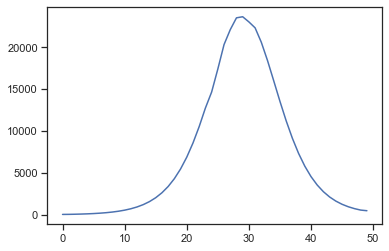

In [27]:
f, ax = plt.subplots()

ax.plot(gdt)

## yield

In [28]:
ydf_use = pd.read_csv('../data/03_model_inputs/yield_vs_stb.csv')

In [29]:
xp = np.linspace(0,1,100)

with open('gam.pickle', 'rb') as f:
    g = pickle.load(f)

preds_df = pd.DataFrame(dict(x=xp, GAM=g.predict(xp)))

## fit

In [30]:
conf_fit = Config(
    'single', 
    n_k=400,
    n_l=50,
    sprays=[1],
    host_on=[False],
    mutation_proportion=MUTATION_PROP,
    mutation_scale_fung=DEFAULT_P * FUNG_MUTATION_SCALE,
    mutation_scale_host=DEFAULT_P * HOST_MUTATION_SCALE,
)

CONFIG
------
I0_single = 0.0098570319660089
beta_single = 0.0078954305108593
cultivar = Mariboss
host_growth = True
host_on = False
k_b = 0.7310132149416496
k_mu = 10.42015277772923
l_b = 6.519374951898358
l_mu = 0.8089142283850663
mutation_on = True
mutation_proportion = 1.234375e-05
mutation_scale_fung = 0.00191996039181228
mutation_scale_host = 0.00191996039181228
n_iterations = None
n_k = 400
n_l = 50
n_years = 25
replace_cultivars = None
sprays = 1
type = single



In [31]:
# control_df = pd.read_csv('../data/03_model_inputs/control_prothio.csv')
control_df = pd.read_csv('../data/03_model_inputs/control_prothio_with_uncertainty.csv')

In [32]:
betas_fit = find_beta_vectorised(
    [0.37]*len(control_df.year.unique()),
    DEFAULT_I0
)

betas_fit

array([0.00877344, 0.00877344, 0.00877344, 0.00877344, 0.00877344,
       0.00877344, 0.00877344, 0.00877344, 0.00877344, 0.00877344,
       0.00877344, 0.00877344, 0.00877344, 0.00877344, 0.00877344,
       0.00877344, 0.00877344, 0.00877344])

In [33]:
soln_fit = simulations_run(
    conf_fit, 
    I0_vec_run=[DEFAULT_I0]*len(betas_fit),
    beta_vec_run=betas_fit,
)

________________________________________________________________________________
[Memory] Calling polymodel.run.simulations_run...
simulations_run(<polymodel.config.Config object at 0x00000147A6610F10>, I0_vec_run=[ 0.0098570319660089,
  0.0098570319660089,
  0.0098570319660089,
  0.0098570319660089,
  0.0098570319660089,
  0.0098570319660089,
  0.0098570319660089,
  0.0098570319660089,
  0.0098570319660089,
  0.0098570319660089,
  0.0098570319660089,
  0.0098570319660089,
  0.0098570319660089,
  0.0098570319660089,
  0.0098570319660089,
  0.0098570319660089,
  0.0098570319660089,
  0.0098570319660089], beta_vec_run=array([0.008773, 0.008773, 0.008773, 0.008773, 0.008773, 0.008773,
       0.008773, 0.008773, 0.008773, 0.008773, 0.008773, 0.008773,
       0.008773, 0.008773, 0.008773, 0.008773, 0.008773, 0.008773]))
running simulation
_________________________________________________simulations_run - 10.3s, 0.2min


In [34]:
dsf = soln_fit['spray_Y1_host_N']['dis_sev']

In [35]:
control_vec = 1 - dsf / 0.37

In [36]:
def fitting_plot(
        stb_vals,
        beta_vals,
        beta_median,
        sev_x,
        sev_pdf,
        beta_x,
        beta_pdf,
        preds_df,
        yield_df,
        control_df,
        control_vec,
    ):
    
    col0 = COLZ[0]
    col1 = COLZ[1]
    col2 = 'black'
    
    fig = make_subplots(
        rows=2,
        cols=2,
        # shared_xaxes=True,
        horizontal_spacing=0.25,
    )
    
    # ROW 1 COL 1
    
    sev_pdf_trc = go.Scatter(
        x=sev_x, y=sev_pdf, showlegend=False,
        line=dict(color=col1, width=3)
    )
    
    stb_hist = go.Histogram(
        x=stb_vals, 
        nbinsx=40,
        xbins={'start': 0, 'end': 100},
        histnorm="probability density",
        showlegend=False,
        marker=dict(color=col0),
    )
    
    trcs_11 = [stb_hist, sev_pdf_trc]
    
    # ROW 1 COL 2
    
    beta_hist = go.Histogram(
        x=beta_vals, 
        nbinsx=40,
        # xbins={'start': 0, 'end': 100},
        histnorm="probability density",
        showlegend=False,
        marker=dict(color=col0),
    )
    
    med_trc = go.Scatter(x=[beta_median, beta_median], y=[0, 260], mode='lines', 
                         line=dict(color=col1, width=3, dash='dash'),
                        showlegend=False)
    
    beta_pdf_trc = go.Scatter(x=beta_x, y=beta_pdf, showlegend=False, 
                              line=dict(color=col1, width=3))
    
    trcs_12 = [beta_hist, med_trc, beta_pdf_trc]
    
    # ROW 2 COL 1
    
    line = go.Scatter(x=100*preds_df.x, y=preds_df.GAM, showlegend=False, 
                         line=dict(color=col1, width=3), mode='lines')
    
    scatter = go.Scatter(x=100*yield_df.stb, y=yield_df.yld, showlegend=False, 
                         # marker=dict(color=col0, opacity=0.5),
                         marker=dict(
                            color=col0,
                            opacity=0.5,
                            size=5,
                            line=dict(width=1, color='rgba(0,0,0,0.5)')
                         ),
                         mode='markers')
    
    trcs_21 = [scatter, line]
    
    # ROW 2 COL 2
    
    model_df = (
        control_df
        .groupby('year').first()
        .reset_index()
        .loc[:, ['year']]
        .assign(model=100*control_vec)
    )
    
    scatter_c = go.Scatter(
        x=control_df.year + np.random.normal(0, 0.05, len(control_df)), 
        y=control_df.control_with_noise_t,
        showlegend=False,
        marker=dict(
            color=col0,
            opacity=0.1,
            size=5,
            line=dict(width=1, color='rgba(0,0,0,0.5)')
        ),
        mode='markers')

    split_year = floor(
        control_df.year.min() - 1
        + TRAIN_TEST_SPLIT_PROPORTION * (1 + control_df.year.max() - control_df.year.min())
    )
    
    cdft = model_df.loc[lambda df: df.year<=split_year]
    cdfte = model_df.loc[lambda df: df.year>=split_year]
    
    line_train = go.Scatter(x=cdft.year, y=cdft.model, showlegend=False,
                          line=dict(color=col1, width=3.5), mode='lines')
    
    line_test = go.Scatter(x=cdfte.year, y=cdfte.model, showlegend=False,
                          line=dict(color=col1, width=4, dash='dot'), mode='lines')
    
#     line_new = go.Scatter(x=cdfte.year, y=cdfte.model, showlegend=False,
#                           line=dict(color='red', dash='dot'), mode='lines')
                
    trcs_22 = [scatter_c, line_train, line_test]
    
    fig.add_traces(trcs_11, rows=1, cols=1)
    fig.add_traces(trcs_21, rows=2, cols=1)
    fig.add_traces(trcs_12, rows=1, cols=2)
    fig.add_traces(trcs_22, rows=2, cols=2)
    
    # ANNOTATIONS
    
    row1 = 1.05
    row2 = 0.5
    
    col1 = -0.01
    col2 = 0.5
    
    annotz = [
        get_text_annotation(col1, row1, 'A', size=20),
        get_text_annotation(col1, row2, 'B', size=20),
        get_text_annotation(col2, row1, 'C', size=20),
        get_text_annotation(col2, row2, 'D', size=20),
    ]
    
    fig.update_layout(standard_layout(True, height=750))
    fig.update_layout(font=dict(size=14))
    
    fig.update_xaxes(title='Severity', row=1, col=1)
    fig.update_xaxes(title='Infection rate (' + u'\u03B2' + ', dd<sup>-1</sup>)', row=1, col=2)
    
    fig.update_xaxes(title='Severity', row=2, col=1)
    fig.update_xaxes(title='Year', row=2, col=2)
    
    fig.update_yaxes(title='Probability density', row=1, col=1)
    fig.update_yaxes(title='Probability density', row=1, col=2)
    fig.update_yaxes(title='Yield (tons/ha)', row=2, col=1)
    fig.update_yaxes(title='Control (%)', row=2, col=2)
    
    return fig

## FIG

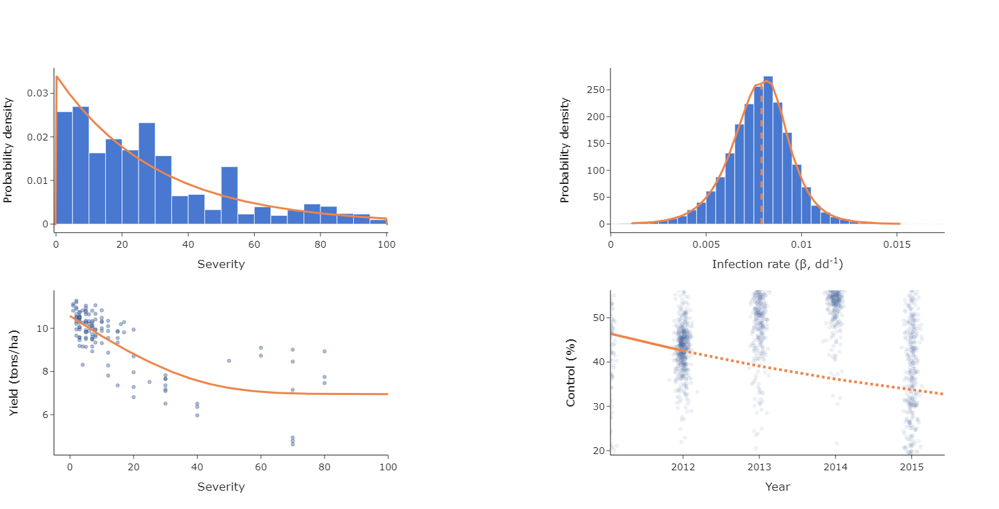

In [37]:
f = fitting_plot(
    stb_values.stb,
    beta_vals,
    DEFAULT_BETA,
    sev_x,
    severity_pdf,
    beta_xs,
    beta_pdf,
    preds_df,
    ydf_use,
    control_df,
    control_vec,
)

f.show()

In [38]:
f.write_image('../figures/paper_figs/fig2_fitting.png')

## Econ for Nik

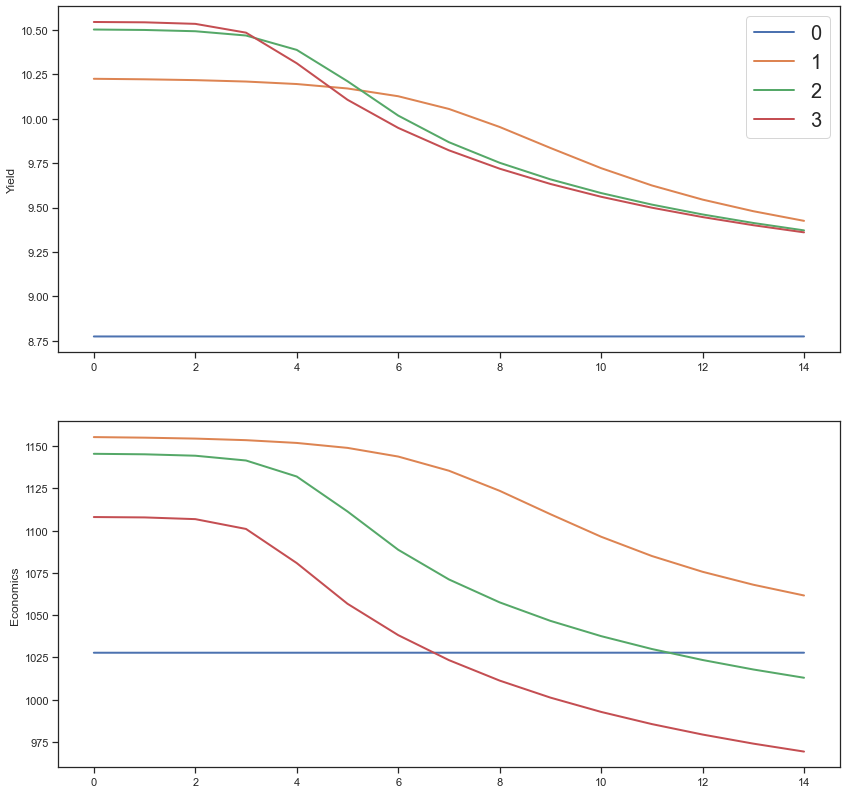

In [65]:
f, ax = plt.subplots(2, 1, figsize=(14,14))


ax[0].plot(sf3['spray_N_host_N']['yield_vec'], label='0', lw=2)
ax[0].plot(sf3['spray_Y1_host_N']['yield_vec'], label='1', lw=2)
ax[0].plot(sf3['spray_Y2_host_N']['yield_vec'], label='2', lw=2)
ax[0].plot(sf3['spray_Y3_host_N']['yield_vec'], label='3', lw=2)

ax[1].plot(sf3['spray_N_host_N']['econ'], label='0', lw=2)
ax[1].plot(sf3['spray_Y1_host_N']['econ'], label='1', lw=2)
ax[1].plot(sf3['spray_Y2_host_N']['econ'], label='2', lw=2)
ax[1].plot(sf3['spray_Y3_host_N']['econ'], label='3', lw=2)

ax[0].set_ylabel('Yield')
ax[1].set_ylabel('Economics')

ax[0].legend(fontsize=20)

In [66]:
f.savefig('../figures/paper_figs/yield_for_Nik.jpg')

# Fig 3 - comparison (1 vs 2 vs 3 sprays)

Relies on `cluster/median.py`, `cluster/median.submit` and `cluster/median_pp.py`.

In [45]:
csf3 = Config(
        type='multi',
        sprays=[0, 1, 2, 3],
        host_on=[False],
        n_years=15,
        n_k=500,
        n_l=50,
        n_iterations=5,
        mutation_proportion=MUTATION_PROP,
        mutation_scale_fung=FUNG_MUTATION_SCALE*DEFAULT_P,
        mutation_scale_host=HOST_MUTATION_SCALE*DEFAULT_P,
)

CONFIG
------
I0_single = 0.0098570319660089
beta_multi = 0.00755103, 0.00871998, 0.00706794, ..., 0.00685062, 0...
cultivar = Mariboss
host_growth = True
host_on = False
k_b = 0.7310132149416496
k_mu = 10.42015277772923
l_b = 6.519374951898358
l_mu = 0.8089142283850663
mutation_on = True
mutation_proportion = 1.234375e-05
mutation_scale_fung = 0.00191996039181228
mutation_scale_host = 0.00191996039181228
n_iterations = 5
n_k = 500
n_l = 50
n_years = 15
replace_cultivars = None
sprays = 0, 1, 2, 3
type = multi



In [46]:
ys_gpd = pd.read_csv('../data/05_outputs/fig3/fig3_ys_df_grouped.csv')

ys_gpd.head(2), ys_gpd.shape

(   sprays  year  Unnamed: 0       yld        sev
 0       0     0         0.0       NaN        NaN
 1       0     1         1.0  8.783815  20.312462,
 (64, 5))

In [47]:
f_gpd = pd.read_csv('../data/05_outputs/fig3/fig3_f_df_grouped.csv')

f_gpd.head(2), f_gpd.shape

(   sprays  year  Unnamed: 0  fung_dist_0  fung_dist_1  fung_dist_2  \
 0       0     0         0.0     0.882530     0.045151     0.020612   
 1       0     1         1.0     0.881918     0.045157     0.020635   
 
    fung_dist_3  fung_dist_4  fung_dist_5  fung_dist_6  ...  fung_dist_490  \
 0     0.012065     0.007957     0.005637     0.004192  ...   3.469026e-19   
 1     0.012092     0.007985     0.005667     0.004221  ...   8.209214e-19   
 
    fung_dist_491  fung_dist_492  fung_dist_493  fung_dist_494  fung_dist_495  \
 0   1.656756e-19   7.228304e-20   2.808972e-20   9.364510e-21   2.524710e-21   
 1   5.875349e-19   4.473226e-19   3.611594e-19   3.048591e-19   2.644180e-19   
 
    fung_dist_496  fung_dist_497  fung_dist_498  fung_dist_499  
 0   4.979059e-22   5.938748e-23   2.802354e-24   1.425432e-26  
 1   2.323767e-19   2.051560e-19   1.812262e-19   1.599649e-19  
 
 [2 rows x 503 columns],
 (64, 503))

In [142]:
def comparison_single(
    ys_gpd,
    f_gpd,
    config,
    ):
    
    fig = make_subplots(
        rows=3,
        cols=2,
        shared_xaxes=True,
        horizontal_spacing=0.25,
    )
    
    
    xx = ys_gpd.loc[lambda df: df.sprays==0].year
    
    # cols = px.colors.sequential.Plasma
    cols = px.colors.sequential.Viridis
    col0 = 'rgb(0.5,0.5,0.5)'
    # cols[6]
    col1 = cols[6]
    col2 = cols[3]
    col3 = cols[0]
    
    # ROW 1
    
    trc0 = go.Scatter(x=xx, y=ys_gpd.loc[lambda df: df.sprays==0].sev, showlegend=False, mode='lines',
                      line=dict(color=col0, dash='dot'))
    trc1 = go.Scatter(x=xx, y=ys_gpd.loc[lambda df: df.sprays==1].sev, showlegend=False, mode='lines',
                      line=dict(color=col1, dash='dashdot'))
    trc2 = go.Scatter(x=xx, y=ys_gpd.loc[lambda df: df.sprays==2].sev, showlegend=False, mode='lines',
                      line=dict(color=col2, dash='dash'))
    trc3 = go.Scatter(x=xx, y=ys_gpd.loc[lambda df: df.sprays==3].sev, showlegend=False, mode='lines',
                      line=dict(color=col3))
    
    trcs_11 = [trc0, trc1, trc2, trc3]
    
    # ROW 2    
    
    trc0 = go.Scatter(x=xx, y=ys_gpd.loc[lambda df: df.sprays==0].yld, showlegend=False, mode='lines',
                      line=dict(color=col0, dash='dot'))
    trc1 = go.Scatter(x=xx, y=ys_gpd.loc[lambda df: df.sprays==1].yld, showlegend=False, mode='lines',
                      line=dict(color=col1, dash='dashdot'))
    trc2 = go.Scatter(x=xx, y=ys_gpd.loc[lambda df: df.sprays==2].yld, showlegend=False,  mode='lines',
                      line=dict(color=col2, dash='dash'))
    trc3 = go.Scatter(x=xx, y=ys_gpd.loc[lambda df: df.sprays==3].yld, showlegend=False,  mode='lines',
                      line=dict(color=col3))
    
    trcs_21 = [trc0, trc1, trc2, trc3]
    
    # ROW 3 COL 1
    
    
    
    fd1 = np.array(f_gpd.loc[lambda x: x.sprays==1].drop(['sprays', 'year'], axis=1)).T
    fd2 = np.array(f_gpd.loc[lambda x: x.sprays==2].drop(['sprays', 'year'], axis=1)).T
    fd3 = np.array(f_gpd.loc[lambda x: x.sprays==3].drop(['sprays', 'year'], axis=1)).T
    
    k_vec = trait_vec(fd1.shape[0])
    
    dm1 = generate_dist_mean(fd1, k_vec)
    dm2 = generate_dist_mean(fd2, k_vec)
    dm3 = generate_dist_mean(fd3, k_vec)
    
    trc1 = go.Scatter(x=np.arange(len(dm1)), y=dm1, showlegend=False, mode='lines',
                      line=dict(color=col1, dash='dashdot'))
    
    trc2 = go.Scatter(x=np.arange(len(dm2)), y=dm2, showlegend=False, mode='lines',
                      line=dict(color=col2, dash='dash'))
    
    trc3 = go.Scatter(x=np.arange(len(dm3)), y=dm3, showlegend=False, mode='lines',
                      line=dict(color=col3))
    
    trcs_31 = [trc1, trc2, trc3]
    
    # ROW 1,2,3, COL 2
    scale_factor = 0.30 # 0.35
    FILL_OPAC = 0.3
    
    dict1 = dict(fung_dists=fd1, host_dists=np.array([]))
    dict2 = dict(fung_dists=fd2, host_dists=np.array([]))
    dict3 = dict(fung_dists=fd3, host_dists=np.array([]))
    
    dists1 = generate_dists(dict1, config, scale_factor)
    trcs_12 = get_dist_traces(dists1, 'fung', 
                              hex_to_rgb(col1),
                              # 'rgba(0,0,255,1)', 
                              3,
                              fill_opacity=FILL_OPAC)
    
    dists2 = generate_dists(dict2, config, scale_factor)
    trcs_22 = get_dist_traces(dists2, 'fung', 
                              hex_to_rgb(col2),
                              # 'rgba(0,0,255,1)',
                              3,
                              fill_opacity=FILL_OPAC)
    
    dists3 = generate_dists(dict3, config, scale_factor)
    trcs_32 = get_dist_traces(dists3, 'fung',
                              hex_to_rgb(col3),
                              # 'rgba(0,0,255,1)',
                              3,
                              fill_opacity=FILL_OPAC)
    
    # ANNOTATIONS
    
    col_1 = -0.01
    col_2 = 0.62
    
    row1 = 1.05
    row2 = 0.68
    row3 = 0.32
    
    
    annotz = [
        
        get_text_annotation(-1, 20.4, '0', xanchor='left', yanchor='middle', color=col0, refs='1'),
        get_text_annotation(-1, 4.21, '1', xanchor='left', yanchor='middle', color=col1, refs='1'),
        get_text_annotation(-1, 1.2, '2', xanchor='left', yanchor='middle', color=col2, refs='1'),
        get_text_annotation(-1, -0.8, '3', xanchor='left', yanchor='middle', color=col3, refs='1'),
        
        get_text_annotation(-1, 10.60, '3', xanchor='left', yanchor='middle', color=col3, refs='3'),
        get_text_annotation(-1, 10.44, '2', xanchor='left', yanchor='middle', color=col2, refs='3'),
        get_text_annotation(-1, 10.22, '1', xanchor='left', yanchor='middle', color=col1, refs='3'),
        get_text_annotation(-1, 8.78, '0', xanchor='left', yanchor='middle', color=col0, refs='3'),
        
        get_text_annotation(15.25, 0.795, '3', xanchor='left', yanchor='middle', color=col3, refs='5'),
        get_text_annotation(15.25, 0.695, '2', xanchor='left', yanchor='middle', color=col2, refs='5'),
        get_text_annotation(15.25, 0.47, '1', xanchor='left', yanchor='middle', color=col1, refs='5'),
        
        get_text_annotation(col_1, row1, 'A', size=20),
        get_text_annotation(col_1, row2, 'B', size=20),
        get_text_annotation(col_1, row3, 'C', size=20),
        get_text_annotation(col_2, row1, 'D', size=20),
        get_text_annotation(col_2, row2, 'E', size=20),
        get_text_annotation(col_2, row3, 'F', size=20),

    ]
    
    # LAYOUT
    
    fig.add_traces(trcs_11, rows=1, cols=1)
    fig.add_traces(trcs_21, rows=2, cols=1)
    fig.add_traces(trcs_31, rows=3, cols=1)
    
    fig.add_traces(trcs_12, rows=1, cols=2)
    fig.add_traces(trcs_22, rows=2, cols=2)
    fig.add_traces(trcs_32, rows=3, cols=2)
    
    fig.update_layout(standard_layout(True, height=750))
    fig.update_layout(font=dict(size=14))
    
    fig.update_layout(annotations=annotz)
    
    range_1 = [-1.5, 17]
    range_2 = [-0.5, 19]
    
    # range_1 = [-1.5, 26]
    # range_2 = [-0.5, 26]
    
    # fig.update_xaxes(row=1, col=1, range=range_)
    # fig.update_xaxes(row=2, col=1, range=range_)
    fig.update_xaxes(title='Time (years)', row=3, col=1, range=range_1)
    
    fig.update_xaxes(row=1, col=2, tickvals=np.arange(0, 16, 3))
    fig.update_xaxes(row=2, col=2, tickvals=np.arange(0, 16, 3))
    fig.update_xaxes(title='Time (years)', row=3, col=2, range=range_2, tickvals=np.arange(0, 16, 3))
    
    fig.update_yaxes(title='Severity (%)', row=1, col=1)
    fig.update_yaxes(title='Yield (tons/ha)', row=2, col=1)
    fig.update_yaxes(title='Trait mean', row=3, col=1)
    
    fig.update_yaxes(title='Trait distribution<br>(1 spray)', row=1, col=2)
    fig.update_yaxes(title='Trait distribution<br>(2 sprays)', row=2, col=2)
    fig.update_yaxes(title='Trait distribution<br>(3 sprays)', row=3, col=2)
    
    return fig

## FIG

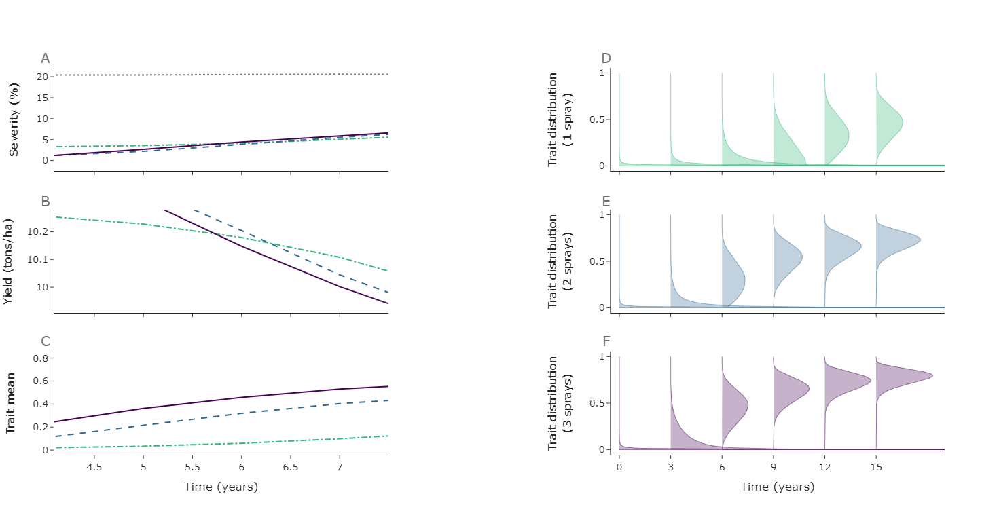

In [143]:
f = comparison_single(
    ys_gpd,
    f_gpd,
    csf3,
)

f.show()

In [144]:
f.write_image('../figures/paper_figs/fig3_comparison_median_10000.png')

## Look at mean vs median

NB now using more model runs (5000 not 2000) for this

In [5]:
# ys_df = pd.read_csv('../data/05_outputs/fig3_ys_df_combined.csv').iloc[:, 2:]
# ys_df.shape

(128000, 5)

In [6]:
# f_df = pd.read_csv('../data/05_outputs/fig3_f_df_combined.csv').iloc[:, 2:]
# f_df.shape

(128000, 503)

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


<AxesSubplot:xlabel='year', ylabel='yld'>

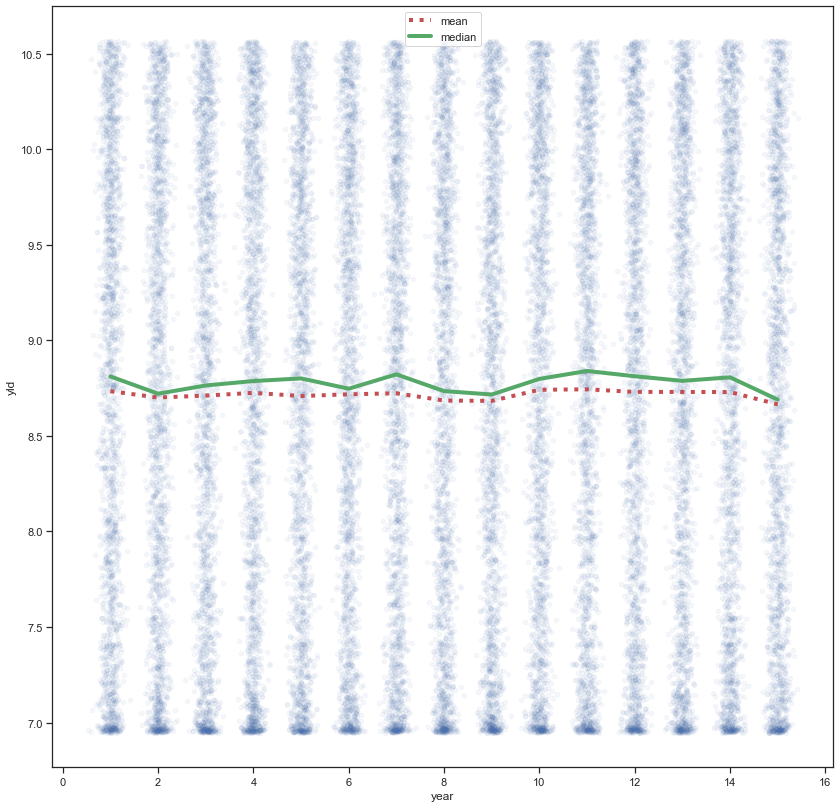

In [59]:
f, ax = plt.subplots(figsize=(14,14))

SPRAYS = 0

(
    ys_df
    .loc[lambda x: x.sprays==SPRAYS]
    .assign(yearnoise = lambda df: df.year + np.random.normal(0, 0.12, size=df.shape[0]))
    .plot.scatter(x='yearnoise', y='yld', alpha=0.05, ax=ax)
)

ys_df.loc[lambda x: x.sprays==SPRAYS].groupby('year').mean().reset_index().plot(x='year', y='yld', ax=ax, c='r', ls=':', label='mean', lw=4)

ys_df.loc[lambda x: x.sprays==SPRAYS].groupby('year').median().reset_index().plot(x='year', y='yld', ax=ax, c='g', label='median', lw=4)

In [60]:
f.savefig(f'../figures/paper_figs/forNik_sprays{SPRAYS}.jpg')

<AxesSubplot:xlabel='year'>

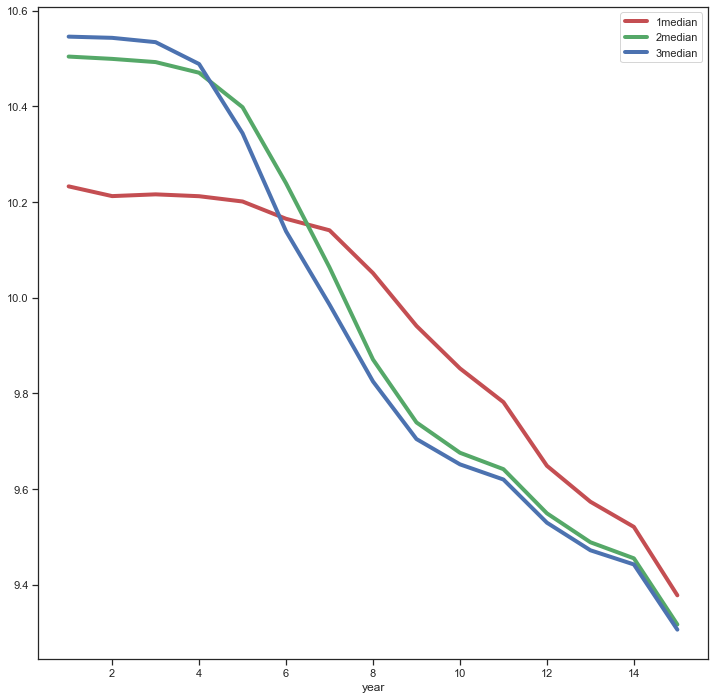

In [54]:
f, ax = plt.subplots(figsize=(12,12))

ys_df.loc[lambda x: x.sprays==1].groupby('year').median().reset_index().plot(x='year', y='yld', ax=ax, c='r', label='1median', lw=4)
ys_df.loc[lambda x: x.sprays==2].groupby('year').median().reset_index().plot(x='year', y='yld', ax=ax, c='g', label='2median', lw=4)
ys_df.loc[lambda x: x.sprays==3].groupby('year').median().reset_index().plot(x='year', y='yld', ax=ax, c='b', label='3median', lw=4)

In [55]:
f.savefig('../figures/paper_figs/forNikmedians.jpg')

## Testing dist transformation

In [287]:
k_vec = sf3['spray_Y1_host_N']['k_vec']

In [301]:
v_vec = np.log(k_vec/(1-k_vec))

(-0.1, 20.0)

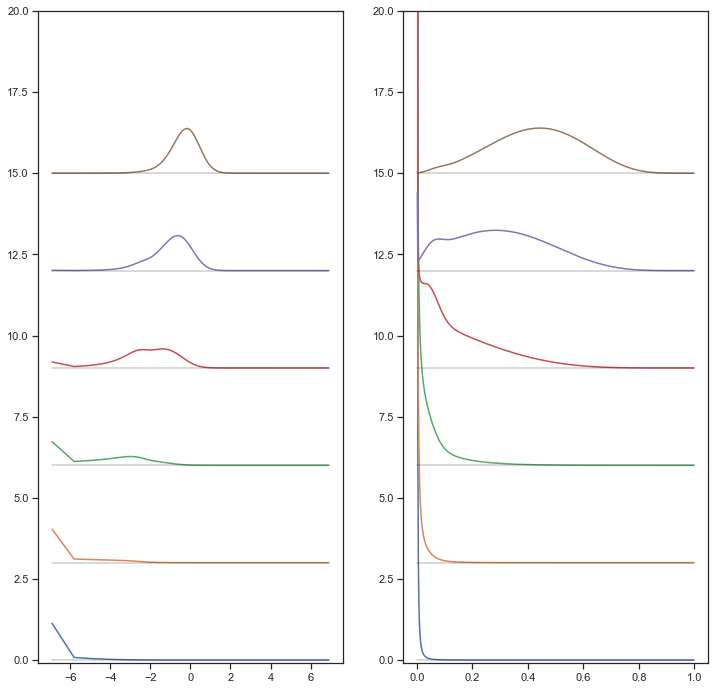

In [425]:
f, ax = plt.subplots(1, 2, figsize=(12,12))

scale_1 = 1200
scale_2 = 300

for ii in range(0, 16, 3):
    fung_dist = sf3['spray_Y1_host_N']['fung_dists'][:, ii]
    p_vec = fung_dist * k_vec * (1-k_vec)
    
    ax[0].plot(v_vec, ii+scale_1*p_vec, label=f'Year {ii}')
    ax[0].plot(v_vec, ii*np.ones(v_vec.shape), c='black', alpha=0.2)

    ax[1].plot(k_vec, ii+scale_2*fung_dist)
    ax[1].plot(k_vec, ii*np.ones(k_vec.shape), c='black', alpha=0.2)

# ax[0].legend()
ax[0].set_ylim([-0.1,20])
ax[1].set_ylim([-0.1,20])

In [424]:
f.savefig('../figures/paper_figs/logit_transform_3_spray.jpg')

### Dataframe

In [411]:
colnames = [f'year{ii}' for ii in range(16)]

In [412]:
df = (
    pd.DataFrame(sf3['spray_Y1_host_N']['fung_dists'], columns=colnames)
)

In [413]:
df2 = df.mul(k_vec, axis=0).add_prefix('logit_')

In [414]:
df_out = (
    pd.concat([
        df.assign(k_values = k_vec),
        df2.assign(logit_values = v_vec)
    ], axis=1)
)

In [415]:
df_out

,year0,year1,year2,year3,year4,year5,year6,year7,year8,year9,...,logit_year7,logit_year8,logit_year9,logit_year10,logit_year11,logit_year12,logit_year13,logit_year14,logit_year15,logit_values
0,9.443922e-01,9.260849e-01,9.002134e-01,8.627540e-01,8.075368e-01,7.260348e-01,6.096503e-01,4.582640e-01,2.933179e-01,1.543642e-01,...,4.582640e-04,2.933179e-04,1.543642e-04,6.689016e-05,2.462571e-05,7.998577e-06,2.362700e-06,6.484615e-07,1.678611e-07,-6.906755
1,2.257423e-02,2.546404e-02,2.845041e-02,3.131805e-02,3.364909e-02,3.470925e-02,3.342327e-02,2.880004e-02,2.112399e-02,1.273547e-02,...,8.640012e-05,6.337197e-05,3.820641e-05,1.896158e-05,7.993537e-06,2.972662e-06,1.005322e-06,3.159189e-07,9.365741e-08,-5.806138
2,9.835878e-03,1.199504e-02,1.446367e-02,1.716008e-02,1.985121e-02,2.202961e-02,2.280854e-02,2.112173e-02,1.664363e-02,1.077722e-02,...,1.056086e-04,8.321816e-05,5.388611e-05,2.871749e-05,1.299795e-05,5.189104e-06,1.883723e-06,6.353363e-07,2.021243e-07,-5.293305
3,5.609072e-03,7.255019e-03,9.254560e-03,1.159450e-02,1.414563e-02,1.654078e-02,1.803381e-02,1.757800e-02,1.457490e-02,9.928657e-03,...,1.230460e-04,1.020243e-04,6.950060e-05,3.896023e-05,1.854687e-05,7.787147e-06,2.972824e-06,1.054379e-06,3.527088e-07,-4.954821
4,3.635314e-03,4.940228e-03,6.598814e-03,8.638025e-03,1.099546e-02,1.340184e-02,1.522099e-02,1.544886e-02,1.333492e-02,9.454990e-03,...,1.390397e-04,1.200143e-04,8.509491e-05,4.964519e-05,2.459455e-05,1.074588e-05,4.268888e-06,1.575471e-06,5.483747e-07,-4.701490
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
495,1.549204e-20,7.294875e-18,9.349941e-17,8.908651e-16,7.382799e-15,5.515776e-14,3.697941e-13,2.159267e-12,1.052273e-11,4.152331e-11,...,2.139834e-12,1.042803e-11,4.114960e-11,1.321015e-10,3.568242e-10,8.436385e-10,1.802059e-09,3.556683e-09,6.589241e-09,4.701490
496,3.485317e-21,6.369492e-18,8.216401e-17,7.852118e-16,6.521186e-15,4.880848e-14,3.277624e-13,1.916795e-12,9.355000e-12,3.696901e-11,...,1.903378e-12,9.289515e-12,3.671023e-11,1.180184e-10,3.192348e-10,7.558264e-10,1.616745e-09,3.195383e-09,5.928126e-09,4.954821
497,4.924766e-22,5.597410e-18,7.240446e-17,6.931725e-16,5.765619e-15,4.321542e-14,2.906079e-13,1.701842e-12,8.317200e-12,3.291232e-11,...,1.693333e-12,8.275614e-12,3.274776e-11,1.054219e-10,2.855469e-10,6.769805e-10,1.450052e-09,2.869815e-09,5.331373e-09,5.293305
498,2.938158e-23,4.925563e-18,6.381198e-17,6.117464e-16,5.095097e-15,3.823988e-14,2.574870e-13,1.509862e-12,7.388682e-12,2.927667e-11,...,1.505333e-12,7.366516e-12,2.918884e-11,9.408954e-11,2.551912e-10,6.058206e-10,1.299372e-09,2.575064e-09,4.790267e-09,5.806138


In [416]:
df_out.to_csv('../data/03_model_inputs/forNikDists.csv')

(-0.001, 0.025)

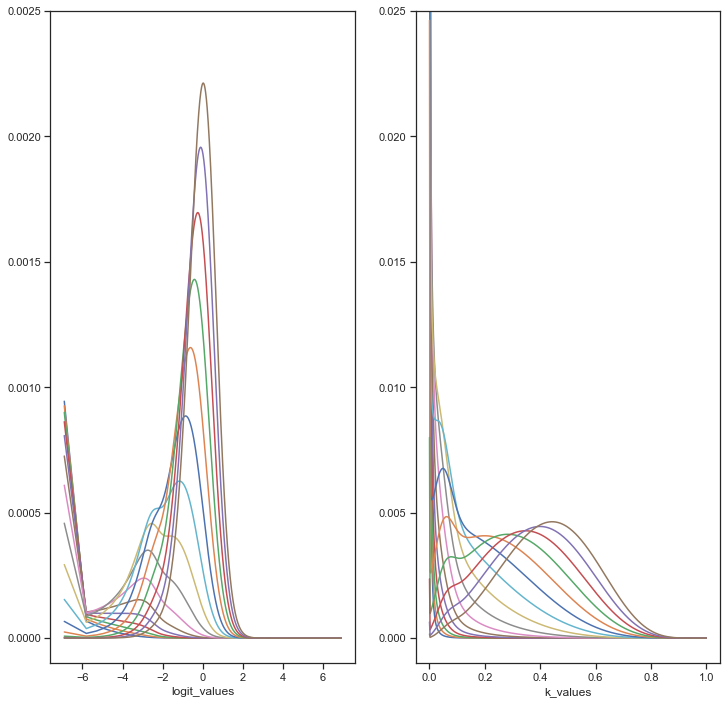

In [408]:
f, ax = plt.subplots(1, 2, figsize=(12,12))

(
    df_out
    .filter(like='logit_')
    .set_index('logit_values')
    .plot(ax=ax[0], legend=False)
)

(
    df_out
    .filter(regex='^((?!logit).)*$')
    .set_index('k_values')
    .plot(ax=ax[1], legend=False)
)

ax[0].set_ylim([-0.0001,0.0025])
ax[1].set_ylim([-0.001,0.025])

# Fig 4 - stochasticity

Want it with `n_k = 400, n_its=1000` in the end

Use `cluster/f4_fung_stoch.submit`

In [52]:
ds_d02 = pd.read_csv('../data/05_outputs/fig4/fig4_all_ds_d02.csv').filter(regex='^((?!year.).)*$').filter(like='y').set_index('year')
ds_d12 = pd.read_csv('../data/05_outputs/fig4/fig4_all_ds_d12.csv').filter(regex='^((?!year.).)*$').filter(like='y').set_index('year')
ds_d32 = pd.read_csv('../data/05_outputs/fig4/fig4_all_ds_d32.csv').filter(regex='^((?!year.).)*$').filter(like='y').set_index('year')

y_d02 = pd.read_csv('../data/05_outputs/fig4/fig4_all_y_d02.csv').filter(regex='^((?!year.).)*$').filter(like='y').set_index('year')
y_d12 = pd.read_csv('../data/05_outputs/fig4/fig4_all_y_d12.csv').filter(regex='^((?!year.).)*$').filter(like='y').set_index('year')
y_d32 = pd.read_csv('../data/05_outputs/fig4/fig4_all_y_d32.csv').filter(regex='^((?!year.).)*$').filter(like='y').set_index('year')

fd_diff02 = pd.read_csv('../data/05_outputs/fig4/fig4_all_fd_diff02.csv').filter(regex='^((?!year.).)*$').filter(like='y').set_index('year')
fd_diff12 = pd.read_csv('../data/05_outputs/fig4/fig4_all_fd_diff12.csv').filter(regex='^((?!year.).)*$').filter(like='y').set_index('year')
fd_diff32 = pd.read_csv('../data/05_outputs/fig4/fig4_all_fd_diff32.csv').filter(regex='^((?!year.).)*$').filter(like='y').set_index('year')

In [57]:
def compare_with_stoch(
    ds_d02,
    ds_d12,
    ds_d32,
    
    y_d02,
    y_d12,
    y_d32,
    
    fd_diff02,
    fd_diff12,
    fd_diff32,
):
    
    fig = make_subplots(
        rows=3,
        cols=3,
        shared_xaxes=True,
        horizontal_spacing=0.12,
    )
    
    col1 = 'rgba(0,255,0,1)'
    col2 = 'rgba(50,50,50,1)'
    col3 = 'rgba(255,0,0,1)'
    
    
    # bds = [5, 95]
    BDS = [5, 25, 75, 95]
    
    
    # ROW 1
    
    trcs_dsd02 = traces_with_uncertainty_bands(ds_d02, bds=BDS, color=col1, showlegend=False)
    trcs_dsd12 = traces_with_uncertainty_bands(ds_d12, bds=BDS, color=col1, showlegend=False)
    trcs_dsd32 = traces_with_uncertainty_bands(ds_d32, bds=BDS, color=col1, showlegend=False)
    
    fig.add_traces(trcs_dsd02, rows=1, cols=1)
    fig.add_traces(trcs_dsd12, rows=1, cols=2)
    fig.add_traces(trcs_dsd32, rows=1, cols=3)
    
    cross_12 = 0.0199 / (0.0199 + 0.7421)
    cross_32 = 0.3152 / (0.3152 + 0.0006)
    
    scatter12 = go.Scatter(
        x=[6 + cross_12],
        y=[0],
        marker=dict(color='rgb(0,0,0)', size=8),
        showlegend=False,
        mode='markers'
    )
    
    scatter32 = go.Scatter(
        x=[3  + cross_32],
        y=[0],
        marker=dict(color='rgb(0,0,0)', size=8),
        showlegend=False,
        mode='markers'
    )
    
    fig.add_traces([scatter12], rows=1, cols=2)
    fig.add_traces([scatter32], rows=1, cols=3)    
    
    # ROW 2
    
    trcs_yd02 = traces_with_uncertainty_bands(y_d02, bds=BDS, color=col1, showlegend=False)
    trcs_yd12 = traces_with_uncertainty_bands(y_d12, bds=BDS, color=col1, showlegend=False)
    trcs_yd32 = traces_with_uncertainty_bands(y_d32, bds=BDS, color=col1, showlegend=False)
    
    fig.add_traces(trcs_yd02, rows=2, cols=1)
    fig.add_traces(trcs_yd12, rows=2, cols=2)
    fig.add_traces(trcs_yd32, rows=2, cols=3)
    
    scatter12b = go.Scatter(
        x=[6 + cross_12],
        y=[0],
        marker=dict(color='rgb(0,0,0)', size=8),
        showlegend=False,
        mode='markers'
    )
    
    scatter32b = go.Scatter(
        x=[3  + cross_32],
        y=[0],
        marker=dict(color='rgb(0,0,0)', size=8),
        showlegend=False,
        mode='markers'
    )
    
    fig.add_traces([scatter12b], rows=2, cols=2)
    fig.add_traces([scatter32b], rows=2, cols=3)
    
    
    
    # ROW 3
    
    fd_diff02 = (
        fd_diff02
        .reset_index()
        .assign(year = lambda df: df.year-1)
        .set_index('year')
    )
    
    fd_diff12 = (
        fd_diff12
        .reset_index()
        .assign(year = lambda df: df.year-1)
        .set_index('year')
    )
    
    fd_diff32 = (
        fd_diff32
        .reset_index()
        .assign(year = lambda df: df.year-1)
        .set_index('year')
    )
    
    trcd02 = traces_with_uncertainty_bands(
        fd_diff02, 
        bds=BDS,
        color=col1,
        name='',
        showlegend=False,
    )
    
    trcd12 = traces_with_uncertainty_bands(
        fd_diff12, 
        bds=BDS,
        color=col1,
        name='',
        showlegend=False,
    )
    
    trcd32 = traces_with_uncertainty_bands(
        fd_diff32, 
        bds=BDS,
        color=col1,
        name='',
        showlegend=False,
    )
    
    fig.add_traces(trcd02, rows=3, cols=1)
    fig.add_traces(trcd12, rows=3, cols=2)
    fig.add_traces(trcd32, rows=3, cols=3)
    
    # ANNOTATIONS
    
    x1 = 0.6
    x2 = 0.7
    x3 = 0.8
    x4 = 0.9
    x5 = 1
    
    yt=1.15
    yb=1.11
    
    eps = 0.018
    
    row1 = 1.06
    row2 = 0.69
    row3 = 0.32
    
    col1 = -0.02
    col2 = 0.35
    col3 = 0.73
    
    annotz = [
        get_text_annotation(0.12, 1.03, '0 sprays', xanchor='center', yanchor='middle'),
        get_text_annotation(0.5, 1.03, '1 spray', xanchor='center', yanchor='middle'),
        get_text_annotation(0.88, 1.03, '3 sprays', xanchor='center', yanchor='middle'),
        
        get_text_annotation(x1, yb-eps, '5', xanchor='center', yanchor='middle', size=14),
        get_text_annotation(x2, yb-eps, '25', xanchor='center', yanchor='middle', size=14),
        get_text_annotation(x3, yb-eps, '50', xanchor='center', yanchor='middle', size=14),
        get_text_annotation(x4, yb-eps, '75', xanchor='center', yanchor='middle', size=14),
        get_text_annotation(x5, yb-eps, '95', xanchor='center', yanchor='middle', size=14),
        
        get_text_annotation(col1, row1, 'A', size=20),
        get_text_annotation(col2, row1, 'D', size=20),
        get_text_annotation(col3, row1, 'G', size=20),
        get_text_annotation(col1, row2, 'B', size=20),
        get_text_annotation(col2, row2, 'E', size=20),
        get_text_annotation(col3, row2, 'H', size=20),
        get_text_annotation(col1, row3, 'C', size=20),
        get_text_annotation(col2, row3, 'F', size=20),
        get_text_annotation(col3, row3, 'I', size=20),
        
    ]
    
    # LAYOUT
    
    fig.update_layout(standard_layout(True, height=750))
    fig.update_layout(font=dict(size=14))
    fig.update_layout(annotations=annotz)
    
    
    
    fig.update_layout(
        shapes=[
            dict(type="rect", xref="paper", yref="paper",
                 x0=x1,
                 x1=x2,
                 y0=yt,
                 y1=yb,
                 line_width=1,
                 line_color="rgb(0,255,0)",
                 fillcolor="rgb(0,255,0)",
                 opacity=0.1,
            ),
            dict(type="rect", xref="paper", yref="paper",
                 x0=x2,
                 x1=x3,
                 y0=yt,
                 y1=yb,
                 line_width=1,
                 line_color="rgb(0,255,0)",
                 fillcolor="rgb(0,255,0)",
                 opacity=0.2,
            ),
            dict(type="line", xref="paper", yref="paper",
                 x0=x3,
                 x1=x3,
                 y0=yt,
                 y1=yb,
                 line_width=2.5,
                 line_color="rgb(0,255,0)",
                 opacity=1,
            ),
            dict(type="rect", xref="paper", yref="paper",
                 x0=x3,
                 x1=x4,
                 y0=yt,
                 y1=yb,
                 line_width=1,
                 line_color="rgb(0,255,0)",
                 fillcolor="rgb(0,255,0)",
                 opacity=0.2,
            ),
            dict(type="rect", xref="paper", yref="paper",
                 x0=x4,
                 x1=x5,
                 y0=yt,
                 y1=yb,
                 line_width=1,
                 line_color="rgb(0,255,0)",
                 fillcolor="rgb(0,255,0)",
                 opacity=0.1,
            ),
            
            dict(type="line", xref="paper", yref="paper",
                 x0=x1,
                 x1=x1,
                 y0=yb,
                 y1=yb-0.25*eps,
                 line_width=1.5,
                 line_color="rgb(110,110,110)",
                 opacity=1,
            ),
            
            dict(type="line", xref="paper", yref="paper",
                 x0=x2,
                 x1=x2,
                 y0=yb,
                 y1=yb-0.25*eps,
                 line_width=1.5,
                 line_color="rgb(110,110,110)",
                 opacity=1,
            ),
            
            dict(type="line", xref="paper", yref="paper",
                 x0=x3,
                 x1=x3,
                 y0=yb,
                 y1=yb-0.25*eps,
                 line_width=1.5,
                 line_color="rgb(110,110,110)",
                 opacity=1,
            ),
            
            dict(type="line", xref="paper", yref="paper",
                 x0=x4,
                 x1=x4,
                 y0=yb,
                 y1=yb-0.25*eps,
                 line_width=1.5,
                 line_color="rgb(110,110,110)",
                 opacity=1,
            ),
            
            dict(type="line", xref="paper", yref="paper",
                 x0=x5,
                 x1=x5,
                 y0=yb,
                 y1=yb-0.25*eps,
                 line_width=1.5,
                 line_color="rgb(110,110,110)",
                 opacity=1,
            ),
    ])
    
    range_ = [-0.5, 15.5]
    
    fig.update_xaxes(title='Time (years)', row=3, col=1, range=range_)
    fig.update_xaxes(title='Time (years)', row=3, col=2, range=range_)
    fig.update_xaxes(title='Time (years)', row=3, col=3, range=range_)
    
    fig.update_yaxes(title='Severity increase (%)', row=1, col=1)
    fig.update_yaxes(title='Yield increase (tons/ha)', row=2, col=1)
    fig.update_yaxes(title='Trait mean increase', row=3, col=1)
    
    return fig

## FIG

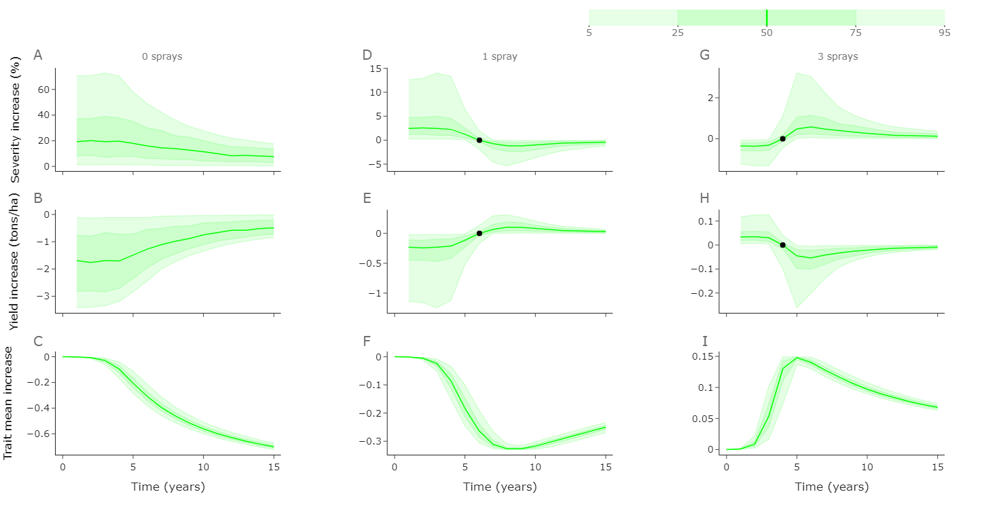

In [58]:
f = compare_with_stoch(
    ds_d02,
    ds_d12,
    ds_d32,
    
    y_d02,
    y_d12,
    y_d32,
    
    fd_diff02,
    fd_diff12,
    fd_diff32,
)

f.show()

In [59]:
f.write_image('../figures/paper_figs/fig4_draft_bands.png')

# Fig 5 - host effect

Need [yield/sev/trait] data from combined dataframes from cluster.

Then get difference.

Then for each variable, get data in the form of dataframe below:

Relies on host_cluster, with `host_on=True,False` to get data. This produces a load of csvs which are combined via `host_run_pp.py`.

## Host on data

In [270]:
host_on = pd.read_csv('../data/05_outputs/fig5/fig5_combined_T.csv')

In [271]:
host_on_yld = (
    host_on
    .filter(like='yld')
    .rename(columns = lambda x: 'y' + x.split('d')[-1])
)

host_on_yld.head(2)

,y0,y1,y2,y3,y4,y5,y6,y7,y8,y9,...,y990,y991,y992,y993,y994,y995,y996,y997,y998,y999
0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,10.540592,10.54058,10.540406,10.494938,10.540727,10.487864,10.47548,10.56326,10.561805,10.514555,...,10.541321,10.527028,10.532318,10.524921,10.540054,10.548925,10.528659,10.539596,10.518266,10.523549


In [272]:
host_on_sev = (
    host_on
    .filter(like='sev')
    .rename(columns = lambda x: 'y' + x.split('v')[-1])
)

host_on_sev.head(2)

,y0,y1,y2,y3,y4,y5,y6,y7,y8,y9,...,y990,y991,y992,y993,y994,y995,y996,y997,y998,y999
0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,0.298779,0.298913,0.30072,0.775045,0.297373,0.848843,0.978027,0.062308,0.077494,0.5704,...,0.291179,0.440278,0.385098,0.462262,0.304393,0.211852,0.423264,0.309177,0.531688,0.47658


In [273]:
host_on_fm = (
    host_on
    .filter(like='fung')
    .rename(columns = lambda x: 'y' + x.split('mean')[-1])
)

host_on_fm.head(2)

,y0,y1,y2,y3,y4,y5,y6,y7,y8,y9,...,y990,y991,y992,y993,y994,y995,y996,y997,y998,y999
0,0.005708,0.005708,0.005708,0.005708,0.005708,0.005708,0.005708,0.005708,0.005708,0.005708,...,0.005708,0.005708,0.005708,0.005708,0.005708,0.005708,0.005708,0.005708,0.005708,0.005708
1,0.006349,0.006349,0.006351,0.006693,0.006348,0.006732,0.006793,0.005955,0.006000,0.006572,...,0.006341,0.006477,0.006431,0.006495,0.006355,0.006247,0.006464,0.006360,0.006545,0.006505


## Host off data

In [274]:
host_off = pd.read_csv('../data/05_outputs/fig5/fig5_combined_F.csv')

In [275]:
host_off_yld = (
    host_off
    .filter(like='yld')
    .rename(columns = lambda x: 'y' + x.split('d')[-1])
)

host_off_yld.head(2)

,y0,y1,y2,y3,y4,y5,y6,y7,y8,y9,...,y990,y991,y992,y993,y994,y995,y996,y997,y998,y999
0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,10.512686,10.512655,10.512241,10.391407,10.513008,10.371085,10.334921,10.560841,10.558277,10.445945,...,10.514422,10.478928,10.492393,10.473473,10.511398,10.531951,10.483117,10.510297,10.455911,10.469892


In [276]:
host_off_sev = (
    host_off
    .filter(like='sev')
    .rename(columns = lambda x: 'y' + x.split('v')[-1])
)

host_off_sev.head(2)

,y0,y1,y2,y3,y4,y5,y6,y7,y8,y9,...,y990,y991,y992,y993,y994,y995,y996,y997,y998,y999
0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,0.589898,0.590218,0.594538,1.85754,0.586541,2.070935,2.451484,0.087545,0.114296,1.28641,...,0.571792,0.942059,0.801594,0.998962,0.603332,0.388928,0.898361,0.61482,1.182281,1.036326


In [277]:
host_off_fm = (
    host_off
    .filter(like='fung')
    .rename(columns = lambda x: 'y' + x.split('mean')[-1])
)

host_off_fm.head(2)

,y0,y1,y2,y3,y4,y5,y6,y7,y8,y9,...,y990,y991,y992,y993,y994,y995,y996,y997,y998,y999
0,0.005708,0.005708,0.005708,0.005708,0.005708,0.005708,0.005708,0.005708,0.005708,0.005708,...,0.005708,0.005708,0.005708,0.005708,0.005708,0.005708,0.005708,0.005708,0.005708,0.005708
1,0.006566,0.006566,0.006569,0.007067,0.006564,0.007124,0.007217,0.006024,0.006083,0.006887,...,0.006554,0.006750,0.006683,0.006775,0.006574,0.006422,0.006730,0.006581,0.006849,0.006791


## Combine

In [278]:
yld_df = host_on_yld - host_off_yld

In [279]:
sev_df = host_on_sev - host_off_sev

In [280]:
fm_df = host_on_fm - host_off_fm

## Get host fitting data

In [281]:
host_fit_config = Config(
    'single', 
    n_k=10,
    n_l=500,
    cultivar='Mariboss',
    mutation_proportion=MUTATION_PROP,
    mutation_scale_fung=DEFAULT_P * FUNG_MUTATION_SCALE,
    mutation_scale_host=DEFAULT_P * HOST_MUTATION_SCALE,
)

CONFIG
------
I0_single = 0.0098570319660089
beta_single = 0.0078954305108593
cultivar = Mariboss
host_growth = True
host_on = None
k_b = 0.7310132149416496
k_mu = 10.42015277772923
l_b = 6.519374951898358
l_mu = 0.8089142283850663
mutation_on = True
mutation_proportion = 1.234375e-05
mutation_scale_fung = 0.00191996039181228
mutation_scale_host = 0.00191996039181228
n_iterations = None
n_k = 10
n_l = 500
n_years = 25
replace_cultivars = None
sprays = None
type = single



In [282]:
my_df = (
    pd.read_csv(
        '../data/03_model_inputs/control_host.csv'
    )
    .iloc[:, 1:]
    .loc[lambda df: df.cultivar == host_fit_config.cultivar]
    .rename(columns={
        'control': 'data_control',
        'min_num': 'n_data',
    })
)

input_severity_df = (
    pd.read_csv(
        '../data/03_model_inputs/input_severities_host.csv'
    )
    .iloc[:, 1:]
    .loc[lambda df: df.cultivar == host_fit_config.cultivar]
    .loc[lambda df: df.year <= my_df.year.max()]
)

input_severities = 0.01*np.array(input_severity_df.worst_stb)

n_years = input_severity_df.shape[0]

I0s = [host_fit_config.I0_single] * n_years

betas = find_beta_vectorised(
    input_severities,
    host_fit_config.I0_single
)

NOT_USED_NUM = 0.5

sevs_trait_off = input_severities

output_trait_on = (
    Simulator(
        host_plant_on=True,
        fungicide_on=False,
        k_mu=NOT_USED_NUM,
        k_b=NOT_USED_NUM,
        l_mu=host_fit_config.l_mu,
        l_b=host_fit_config.l_b,
        config=host_fit_config
    )
    .run_model(
        I0_vec=I0s,
        beta_vec=betas
    )
)

sevs_trait_on = np.asarray(output_trait_on['dis_sev'])

yh = 100 * (1 - sevs_trait_on / sevs_trait_off)

In [285]:
def adding_in_host(yh, sev_data, yield_data, trait_data):
    
    fig = make_subplots(
        rows=4,
        cols=1,
    )
    
    control_df = (
        pd.read_csv('../data/03_model_inputs/control_host.csv')
        .loc[lambda df: df.cultivar=='Mariboss']
        .assign(sizes = lambda df: 3*np.sqrt(df.min_num))
    )
    
    col1 = 'rgba(0,255,0,1)'
    col2 = 'rgba(50,50,50,1)'
    col3 = 'rgba(255,0,0,1)'
    
    
    bds = [2.5, 97.5]
    
    BDS = [5, 25, 75, 95]
    
    
    # ROW 1
    xx = control_df.year
    yy = control_df.control
    
    trc_c = go.Scatter(
        x=xx, y=yy, showlegend=False,
        mode='markers', 
        marker=dict(
            color=COLZ[0],
            opacity=0.5,
            size=control_df.sizes,
        ),
        marker_line_width=1,
        marker_line_color='black',
    )
    
    by_year = (
        control_df
        .groupby('year')
        .mean()
        .reset_index()
        .assign(model_control = yh)
    )
    
    split_year = floor(
        - 1 + by_year.year.min()
        + TRAIN_TEST_SPLIT_PROPORTION * (1 + by_year.year.max() - by_year.year.min())
    )
    
    c_te = by_year.loc[
        lambda df: df.year <= split_year
    ]
    
    c_tr = by_year.loc[
        lambda df: df.year >= split_year
    ]
    
    line_te = go.Scatter(x=c_te.year, y=c_te.model_control, showlegend=False,
               mode='lines', line=dict(color=COLZ[1], width=3))
    
    line_tr = go.Scatter(x=c_tr.year, y=c_tr.model_control, showlegend=False,
               mode='lines', line=dict(color=COLZ[1], width=3, dash='dot'))
    
    trcs_1 = [trc_c, line_te, line_tr]
    
    fig.add_traces(trcs_1, rows=1, cols=1)
    
    
    
    # ROW 2
    
    trcs_dsd = traces_with_uncertainty_bands(sev_data, bds=BDS, color=col1, showlegend=False)
    
    fig.add_traces(trcs_dsd, rows=2, cols=1)
    
    
    
    # ROW 3
        
    trcs_yd = traces_with_uncertainty_bands(yield_data, bds=BDS, color=col1, showlegend=False)
    
    fig.add_traces(trcs_yd, rows=3, cols=1)

    
    # ROW 4
    
    trcs_tm = traces_with_uncertainty_bands(trait_data, bds=BDS, color=col1, showlegend=False)
    
    fig.add_traces(trcs_tm, rows=4, cols=1)
    
    # LAYOUT
    
    x1 = 0.6
    x2 = 0.7
    x3 = 0.8
    x4 = 0.9
    x5 = 1
    
    yt=0.51
    yb=0.48
    eps=0.015
    
    col1 = -0.01
    
    row1 = 1.05
    row2 = 0.78
    row3 = 0.51
    row4 = 0.24
    
    annotz = [
        get_text_annotation(x1, yb-eps, '5', xanchor='center', yanchor='middle', size=14),
        get_text_annotation(x2, yb-eps, '25', xanchor='center', yanchor='middle', size=14),
        get_text_annotation(x3, yb-eps, '50', xanchor='center', yanchor='middle', size=14),
        get_text_annotation(x4, yb-eps, '75', xanchor='center', yanchor='middle', size=14),
        get_text_annotation(x5, yb-eps, '95', xanchor='center', yanchor='middle', size=14),
        
        
        get_text_annotation(col1, row1, 'A', size=20),
        get_text_annotation(col1, row2, 'B', size=20),
        get_text_annotation(col1, row3, 'C', size=20),
        get_text_annotation(col1, row4, 'D', size=20),
    ]
    
    fig.update_layout(standard_layout(True, height=850))
    fig.update_layout(font=dict(size=14))
    fig.update_layout(annotations=annotz)
     
    fig.update_layout(
        shapes=[
            dict(type="rect", xref="paper", yref="paper",
                 x0=x1,
                 x1=x2,
                 y0=yt,
                 y1=yb,
                 line_width=1,
                 line_color="rgb(0,255,0)",
                 fillcolor="rgb(0,255,0)",
                 opacity=0.1,
            ),
            dict(type="rect", xref="paper", yref="paper",
                 x0=x2,
                 x1=x3,
                 y0=yt,
                 y1=yb,
                 line_width=1,
                 line_color="rgb(0,255,0)",
                 fillcolor="rgb(0,255,0)",
                 opacity=0.2,
            ),
            dict(type="line", xref="paper", yref="paper",
                 x0=x3,
                 x1=x3,
                 y0=yt,
                 y1=yb,
                 line_width=2.5,
                 line_color="rgb(0,255,0)",
                 opacity=1,
            ),
            dict(type="rect", xref="paper", yref="paper",
                 x0=x3,
                 x1=x4,
                 y0=yt,
                 y1=yb,
                 line_width=1,
                 line_color="rgb(0,255,0)",
                 fillcolor="rgb(0,255,0)",
                 opacity=0.2,
            ),
            dict(type="rect", xref="paper", yref="paper",
                 x0=x4,
                 x1=x5,
                 y0=yt,
                 y1=yb,
                 line_width=1,
                 line_color="rgb(0,255,0)",
                 fillcolor="rgb(0,255,0)",
                 opacity=0.1,
            ),
            
            dict(type="line", xref="paper", yref="paper",
                 x0=x1,
                 x1=x1,
                 y0=yb,
                 y1=yb-0.25*eps,
                 line_width=1.5,
                 line_color="rgb(110,110,110)",
                 opacity=1,
            ),
            
            dict(type="line", xref="paper", yref="paper",
                 x0=x2,
                 x1=x2,
                 y0=yb,
                 y1=yb-0.25*eps,
                 line_width=1.5,
                 line_color="rgb(110,110,110)",
                 opacity=1,
            ),
            
            dict(type="line", xref="paper", yref="paper",
                 x0=x3,
                 x1=x3,
                 y0=yb,
                 y1=yb-0.25*eps,
                 line_width=1.5,
                 line_color="rgb(110,110,110)",
                 opacity=1,
            ),
            
            dict(type="line", xref="paper", yref="paper",
                 x0=x4,
                 x1=x4,
                 y0=yb,
                 y1=yb-0.25*eps,
                 line_width=1.5,
                 line_color="rgb(110,110,110)",
                 opacity=1,
            ),
            
            dict(type="line", xref="paper", yref="paper",
                 x0=x5,
                 x1=x5,
                 y0=yb,
                 y1=yb-0.25*eps,
                 line_width=1.5,
                 line_color="rgb(110,110,110)",
                 opacity=1,
            ),
    ])
    
    
    range_ = [-0.5, 15.5]
    
    fig.update_xaxes(row=2, col=1, range=range_, tickfont = dict(color='rgba(0,0,0,0)'))
    fig.update_xaxes(row=3, col=1, range=range_, showticklabels=False) #tickfont = dict(color='rgba(0,0,0,0)'))
    fig.update_xaxes(title='Time (years)', row=4, col=1, range=range_)
    
    fig.update_yaxes(title='Control', row=1, col=1)
    fig.update_yaxes(title='Severity increase (%)', row=2, col=1)
    fig.update_yaxes(title='Yield increase<br>(tons/ha)', row=3, col=1)
    fig.update_yaxes(title='Fungicide trait mean<br>increase', row=4, col=1)
    
    return fig

## FIG

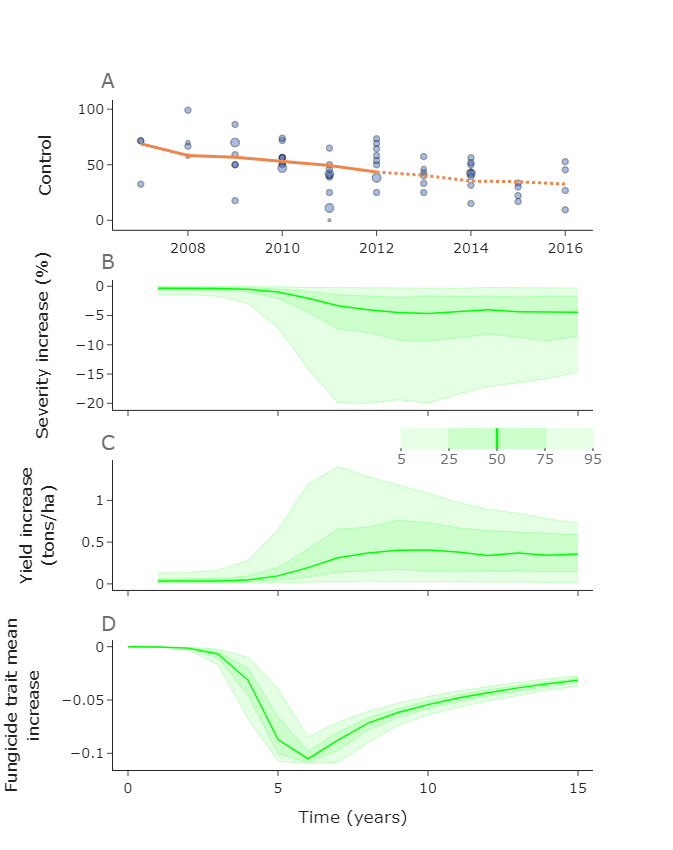

In [292]:
f = adding_in_host(
    yh,
    sev_df,
    yld_df,
    fm_df,
)

f.show()

In [293]:
f.write_image('../figures/paper_figs/fig5_draft.png')

# Fig 6

Fix variance, let mean vary

- A) As host mean varies, how many years for yield to reach X for sprays = 1, 2, 3

- B) Same but for point distribution with no host mutation (host doesn't degrade)

- C) Fungicide distribution mean after years = e.g. 10 for sprays = 1, 2, 3

- D) Host distribution mean after years = e.g. 10 for sprays = 1, 2, 3

So need dataframe with columns:

- sprays
- host mean start
- year 1...N yield
- year 0...N fung mean
- year 0...N host mean

Then each model run is a single row.

Have one df for variance non zero and one for point distribution/no mutation

- A: need new column - year in which yield < X
- B: same as A but for point dist
- C: host mean start vs host_mean_year_10
- D: host_mean_start vs fung_mean_year_10

Use cluster - single run per host mean start value for 1,2,3 sprays

Relies on `cluster/mutual.py` which is called via `cluster/mutual.submit`. This generates data which is combined via `cluster/mutual_pp.py`. Similarly for `mutual_point.py`, submit etc.

## varying host efficacy

In [60]:
def years_above_threshold(df, thresh=10, name='over_th'):
    
    mod = (
        pd.DataFrame(
        df
        .filter(like='yld')
        .T
        )
        .assign(over_th = lambda x: x>thresh)
        .loc[:, ['over_th']]
        .rename(columns={'over_th': name})
    )
    
    return mod.sum()

In [266]:
dfn = pd.read_csv('../data/05_outputs/fig6/fig_6_theoretical_combined.csv').iloc[:, 2:]

eps = 0.15

dfn_use = (
    dfn
    .apply(lambda df: years_above_threshold(df, 10.1, 'over_th1'), axis=1)
    .join(dfn)
    .join(
        dfn
        .apply(lambda df: years_above_threshold(df, 9.5, 'over_th2'), axis=1)
        .join(dfn)
        .loc[:, ['over_th2']]
    )
    .assign(over_th_use = lambda df: df.over_th1 + eps*df.sprays - 2*eps)
)

dfn_use

,over_th1,host_mean_start,sprays,yld1,yld2,yld3,yld4,yld5,yld6,yld7,...,host_mean43,host_mean44,host_mean45,host_mean46,host_mean47,host_mean48,host_mean49,host_mean50,over_th2,over_th_use
0,14,0.01,1,10.567713,10.567270,10.561896,10.529273,10.493188,10.465410,10.441216,...,0.988708,0.989308,0.989848,0.990334,0.990771,0.991164,0.991518,0.991836,25,13.85
1,14,0.01,2,10.567776,10.567684,10.567279,10.565150,10.558314,10.550549,10.544258,...,0.987465,0.988186,0.988837,0.989425,0.989954,0.990430,0.990858,0.991243,26,14.00
2,15,0.01,3,10.567807,10.567775,10.567693,10.567443,10.566644,10.564645,10.561790,...,0.986340,0.987168,0.987919,0.988597,0.989209,0.989760,0.990256,0.990702,27,15.15
3,14,0.02,1,10.567583,10.566703,10.558263,10.525648,10.492392,10.464843,10.440582,...,0.988710,0.989309,0.989848,0.990333,0.990770,0.991163,0.991516,0.991834,25,13.85
4,14,0.02,2,10.567704,10.567520,10.566774,10.563690,10.556838,10.549960,10.543554,...,0.987529,0.988243,0.988888,0.989469,0.989993,0.990465,0.990889,0.991270,26,14.00
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
292,7,0.98,2,10.507103,10.505550,10.501211,10.486240,10.430676,10.286148,10.110264,...,0.991976,0.992140,0.992298,0.992448,0.992592,0.992730,0.992861,0.992986,15,7.00
293,6,0.98,3,10.546959,10.545713,10.540001,10.505682,10.368443,10.190861,10.055018,...,0.991940,0.992106,0.992265,0.992418,0.992563,0.992702,0.992835,0.992961,15,6.15
294,8,0.99,1,10.242875,10.240986,10.238039,10.233113,10.224328,10.207822,10.176131,...,0.994560,0.994588,0.994614,0.994638,0.994661,0.994683,0.994703,0.994721,14,7.85
295,6,0.99,2,10.504566,10.502939,10.498255,10.481709,10.419583,10.261135,10.075477,...,0.994541,0.994570,0.994597,0.994623,0.994647,0.994669,0.994690,0.994710,14,6.00


## Mariboss

In [146]:
cf = Config(
    'single', 
    n_k=50,
    n_l=50,
    sprays=[1],
    host_on=[False],
    mutation_proportion=MUTATION_PROP,
    mutation_scale_fung=DEFAULT_P * FUNG_MUTATION_SCALE,
    mutation_scale_host=DEFAULT_P * HOST_MUTATION_SCALE,
)

CONFIG
------
I0_single = 0.0098570319660089
beta_single = 0.0078954305108593
cultivar = Mariboss
host_growth = True
host_on = False
k_b = 0.7310132149416496
k_mu = 10.42015277772923
l_b = 6.519374951898358
l_mu = 0.8089142283850663
mutation_on = True
mutation_proportion = 1.234375e-05
mutation_scale_fung = 0.00191996039181228
mutation_scale_host = 0.00191996039181228
n_iterations = None
n_k = 50
n_l = 50
n_years = 25
replace_cultivars = None
sprays = 1
type = single



In [147]:
MARIBOSS_MEAN = cf.l_mu

## Replacing

In [148]:
repl_n = (3*list(range(1,50)))
repl_n.sort()

In [149]:
def consecutive_years_above_threshold(df, thresh=10):
    mod = (
        pd.DataFrame(
        df
        .filter(like='yld')
        .T
        )
        .assign(over_th = lambda x: x>thresh)
        .loc[:, ['over_th']]
    )
    
    if len(np.where(~mod)[0])>0:
        return np.where(~mod)[0][0]
    else:
        return 999

In [150]:
dfr = (
    pd.read_csv('../data/05_outputs/fig6/fig_6_replacing_combined.csv').iloc[:, 2:]
    .assign(repl_n = repl_n)
)

dfr_use = (
    dfr.assign(
        over_th = (
        dfr
        .apply(lambda df: consecutive_years_above_threshold(df, thresh=10.1), axis=1)
    ))
)

dfr_use.head(2)

,host_mean_start,sprays,yld1,yld2,yld3,yld4,yld5,yld6,yld7,yld8,...,host_mean93,host_mean94,host_mean95,host_mean96,host_mean97,host_mean98,host_mean99,host_mean100,repl_n,over_th
0,0.808914,1,10.439300,10.438867,10.438214,10.437196,10.435549,10.432791,10.428047,10.419808,...,0.808914,0.808914,0.808914,0.808914,0.808914,0.808914,0.808914,0.808914,1,30
1,0.808914,2,10.536283,10.535807,10.534708,10.531783,10.523080,10.498255,10.448845,10.394122,...,0.808914,0.808914,0.808914,0.808914,0.808914,0.808914,0.808914,0.808914,1,29


## Fig fn

In [267]:
def mutual_figure(df1, df2):

    fig = make_subplots(
        rows=3,
        cols=2,
        # shared_xaxes=True,
        horizontal_spacing=0.25,
        vertical_spacing=0.15,
    )

    cols = px.colors.sequential.Viridis
    col0 = 'rgb(0.5,0.5,0.5)'
    col1 = cols[6]
    col2 = cols[3]
    col3 = cols[0]

    
    
    # ROW 1 COL 1
    s11 = df1.loc[lambda x: x.sprays==1]
    s12 = df1.loc[lambda x: x.sprays==2]
    s13 = df1.loc[lambda x: x.sprays==3]
    
    trcs_thr1 = [
        go.Scatter(
            x=s11.host_mean0,
            y=s11.over_th_use,
            # showlegend=False,
            name='1 spray',
            mode='lines',
            line=dict(color=col1),
        ),
        go.Scatter(
            x=s12.host_mean0,
            y=s12.over_th_use,
            # showlegend=False,
            name='2 sprays',
            mode='lines',
            line=dict(color=col2),
        ),
        go.Scatter(
            x=s13.host_mean0,
            y=s13.over_th_use,
            # showlegend=False,
            name='3 sprays',
            mode='lines',
            line=dict(color=col3),
        ),
        go.Scatter(
            x=[MARIBOSS_MEAN,MARIBOSS_MEAN],
            y=[0, 50],
            mode='lines',
            # showlegend=False,
            name='Mariboss',
            line=dict(color='blue', dash='dot'),
            opacity=0.5,
        )
    ]
    
    fig.add_traces(trcs_thr1, rows=3, cols=1)
    
    
    
    # ROW 1 COL 2
    
    # trcs_thr2 = [
    #     go.Scatter(
    #         x=s11.host_mean0,
    #         y=s11.over_th2,
    #         showlegend=False,
    #         mode='lines',
    #         line=dict(color=col1),
    #     ),
    #     go.Scatter(
    #         x=s12.host_mean0,
    #         y=s12.over_th2,
    #         showlegend=False,
    #         mode='lines',
    #         line=dict(color=col2),
    #     ),
    #     go.Scatter(
    #         x=s13.host_mean0,
    #         y=s13.over_th2,
    #         showlegend=False,
    #         mode='lines',
    #         line=dict(color=col3),
    #     ),
    #     go.Scatter(
    #         x=[MARIBOSS_MEAN,MARIBOSS_MEAN],
    #         y=[0, 50],
    #         mode='lines',
    #         showlegend=False,
    #         line=dict(color='blue', dash='dot'),
    #         opacity=0.5,
    #     )
    # ]
    
    # fig.add_traces(trcs_thr2, rows=3, cols=2)


    
    #     
    #
    # ROW 2 COL 1

    trcs_yld5 = [
        go.Scatter(
            x=s11.host_mean0,
            y=s11.yld5,
            showlegend=False,
            mode='lines',
            line=dict(color=col1),
        ),
        go.Scatter(
            x=s12.host_mean0,
            y=s12.yld5,
            showlegend=False,
            mode='lines',
            line=dict(color=col2),
        ),
        go.Scatter(
            x=s13.host_mean0,
            y=s13.yld5,
            showlegend=False,
            mode='lines',
            line=dict(color=col3),
        ),
        go.Scatter(
            x=[MARIBOSS_MEAN,MARIBOSS_MEAN],
            y=[0,11],
            mode='lines',
            showlegend=False,
            line=dict(color='blue', dash='dot'),
            opacity=0.5,
        )
    ]
    
    fig.add_traces(trcs_yld5, rows=1, cols=1)
    
    #     
    # 
    # ROW 2 COL 2
    trcs_yld10 = [
        go.Scatter(
            x=s11.host_mean0,
            y=s11.yld10,
            showlegend=False,
            mode='lines',
            line=dict(color=col1),
        ),
        go.Scatter(
            x=s12.host_mean0,
            y=s12.yld10,
            showlegend=False,
            mode='lines',
            line=dict(color=col2),
        ),
        go.Scatter(
            x=s13.host_mean0,
            y=s13.yld10,
            showlegend=False,
            mode='lines',
            line=dict(color=col3),
        ),
        go.Scatter(
            x=[MARIBOSS_MEAN,MARIBOSS_MEAN],
            y=[0,11],
            mode='lines',
            showlegend=False,
            line=dict(color='blue', dash='dot'),
            opacity=0.5,
        )
    ]
    
    fig.add_traces(trcs_yld10, rows=1, cols=2)

    #     
    # 
    # ROW 3 COL 1
    trcs_fung_mean = [
        go.Scatter(
            x=s11.host_mean0,
            y=s11.fung_mean10,
            showlegend=False,
            mode='lines',
            line=dict(color=col1),
        ),
        go.Scatter(
            x=s12.host_mean0,
            y=s12.fung_mean10,
            showlegend=False,
            mode='lines',
            line=dict(color=col2),
        ),
        go.Scatter(
            x=s13.host_mean0,
            y=s13.fung_mean10,
            showlegend=False,
            mode='lines',
            line=dict(color=col3),
        ),
        go.Scatter(
            x=[MARIBOSS_MEAN,MARIBOSS_MEAN],
            y=[0,1],
            mode='lines',
            showlegend=False,
            line=dict(color='blue', dash='dot'),
            opacity=0.5,
        )
    ]
    
    fig.add_traces(trcs_fung_mean, rows=2, cols=1)
    
    #     
    #
    # ROW 3 COL 2

    trcs_host_mean = [
        go.Scatter(
            x=s11.host_mean0,
            y=s11.host_mean10,
            showlegend=False,
            mode='lines',
            line=dict(color=col1),
        ),
        go.Scatter(
            x=s12.host_mean0,
            y=s12.host_mean10,
            showlegend=False,
            mode='lines',
            line=dict(color=col2),
        ),
        go.Scatter(
            x=s13.host_mean0,
            y=s13.host_mean10,
            showlegend=False,
            mode='lines',
            line=dict(color=col3),
        ),
        go.Scatter(
            x=[MARIBOSS_MEAN,MARIBOSS_MEAN],
            y=[0,1],
            mode='lines',
            showlegend=False,
            line=dict(color='blue', dash='dot'),
            opacity=0.5,
        )
    ]
    
    fig.add_traces(trcs_host_mean, rows=2, cols=2)
    
    

    
    
    
    
    #
    #
    # Row 4 col 1
    
    s21 = df2.loc[lambda x: x.sprays==1]
    s22 = df2.loc[lambda x: x.sprays==2]
    s23 = df2.loc[lambda x: x.sprays==3]
    
    trcs_repl = [
        go.Scatter(
            x=s21.repl_n,
            y=s21.over_th,
            showlegend=False,
            mode='lines',
            line=dict(color=col1),
        ),
        go.Scatter(
            x=s22.repl_n,
            y=s22.over_th,
            showlegend=False,
            mode='lines',
            line=dict(color=col2),
        ),
        go.Scatter(
            x=s23.repl_n,
            y=s23.over_th,
            showlegend=False,
            mode='lines',
            line=dict(color=col3),
        )
    ]
    
    fig.add_traces(trcs_repl, rows=3, cols=2)
    

    #
    #
    # LAYOUT

    fig.update_layout(standard_layout(True, height=800))
    fig.update_layout(font=dict(size=14))
    fig.update_layout(legend=dict(
        x=0.5, 
        y=1.11,
        # font=dict(size=6),
        xanchor='center',
        orientation='h',
    ))

    #
    #
    # ANNOTATIONS
    
    col_1 = -0.01
    col_2 = 0.62
    
    row1 = 1.05
    row2 = 0.66
    row3 = 0.28

    annotz = [
        
        get_text_annotation(1.09, 10.2, '1', xanchor='right', yanchor='middle', color=col1, refs='1'),
        get_text_annotation(1.09, 10.41, '2', xanchor='right', yanchor='middle', color=col2, refs='1'),
        get_text_annotation(1.09, 10.32, '3', xanchor='right', yanchor='middle', color=col3, refs='1'),
        
        get_text_annotation(1.09, 9.90, '1', xanchor='right', yanchor='middle', color=col1, refs='2'),
        get_text_annotation(1.09, 9.78, '2', xanchor='right', yanchor='middle', color=col2, refs='2'),
        get_text_annotation(1.09, 9.66, '3', xanchor='right', yanchor='middle', color=col3, refs='2'),
        
        get_text_annotation(1.09, 0.23, '1', xanchor='right', yanchor='middle', color=col1, refs='3'),
        get_text_annotation(1.09, 0.55, '2', xanchor='right', yanchor='middle', color=col2, refs='3'),
        get_text_annotation(1.09, 0.655, '3', xanchor='right', yanchor='middle', color=col3, refs='3'),
        
        get_text_annotation(-0.01, 0.89, '1', xanchor='right', yanchor='middle', color=col1, refs='4'),
        get_text_annotation(-0.01, 0.83, '2', xanchor='right', yanchor='middle', color=col2, refs='4'),
        get_text_annotation(-0.01, 0.77, '3', xanchor='right', yanchor='middle', color=col3, refs='4'),
        
        # get_text_annotation(1.09, 8, '1', xanchor='right', yanchor='middle', color=col1, refs='5'),
        # get_text_annotation(-0.01, 13.5, '2', xanchor='right', yanchor='middle', color=col2, refs='5'),
        # get_text_annotation(-0.01, 15.5, '3', xanchor='right', yanchor='middle', color=col3, refs='5'),
        
        # get_text_annotation(1.09, 14, '1', xanchor='right', yanchor='middle', color=col1, refs='2'),
        # get_text_annotation(-0.01, 26, '2', xanchor='right', yanchor='middle', color=col2, refs='2'),
        # get_text_annotation(-0.01, 28, '3', xanchor='right', yanchor='middle', color=col3, refs='2'),


        
        get_text_annotation(col_1, row1, 'A', size=20),
        get_text_annotation(col_1, row2, 'C', size=20),
        get_text_annotation(col_1, row3, 'E', size=20),
        # get_text_annotation(col_1, row4, 'G', size=20),
        get_text_annotation(col_2, row1, 'B', size=20),
        get_text_annotation(col_2, row2, 'D', size=20),
        get_text_annotation(col_2, row3, 'F', size=20),
        
        # get_text_annotation(col_2 + 0.03, row3 - 0.009, 'replacing cultivars', xanchor='left'),
        
        # get_text_annotation(col_2+0.1, row3, 'replacing cultivars', size=18),
        
    ]

    fig.update_layout(annotations=annotz)

    #
    #
    # AXES

    # X
    
    range_ = [-0.15, 1.15]
    fig.update_xaxes(row=1, col=1, range=range_, showgrid=False, showticklabels=False)
    fig.update_xaxes(row=1, col=2, range=range_, showgrid=False, showticklabels=False)
    fig.update_xaxes(row=2, col=1, range=range_, showgrid=False, showticklabels=False)
    # fig.update_xaxes(row=2, col=2, range=range_, showgrid=False, showticklabels=False)
    
    fig.update_xaxes(title_text='Initial host trait mean',
                     row=3, col=1,
                     range=range_,
                     showgrid=False)
    
    fig.update_xaxes(title_text='Initial host trait mean',
                     row=2, col=2,
                     range=range_,
                     showgrid=False)

    
    fig.update_xaxes(title_text='Cultivar replacement frequency',
                     row=3, col=2,
                     range=[0, 15],
                     showgrid=False)

    
    
    # Y
    
    # fig.update_yaxes(title_text='Years above<br>9.5 ton/ha',
    #                  row=1, col=2,
    #                  range=[12,29],
    #                  showgrid=False)

    fig.update_yaxes(title_text='Yield, year 5',
                     row=1, col=1,
                     range=[10.15, 10.6],
                     showgrid=False)
    
    fig.update_yaxes(title_text='Yield, year 10',
                     row=1, col=2,
                     range=[9.55, 10.6],
                     showgrid=False)
    
    fig.update_yaxes(title_text='Fungicide trait mean,<br>year 10',
                     row=2, col=1,
                     range=[-0.05, 0.7],
                     showgrid=False)
    
    
    fig.update_yaxes(title_text='Host trait mean,<br>year 10',
                     row=2, col=2,
                     range=[0.74, 1.02],
                     showgrid=False)

    
    fig.update_yaxes(title_text='Years above<br>10.1 tons/ha',
                     row=3, col=1,
                     range=[5,16],
                     showgrid=False)
        
    fig.update_yaxes(title_text='Years above<br>10.1 tons/ha',
                     row=3, col=2,
                     range=[8,31],
                     showgrid=False)
    

    return fig

Interesting here to explore the effect of different choices of:

- threshold for yield (9.5/10)
- years to explore fungicide/host means (5/10/15)

## FIG

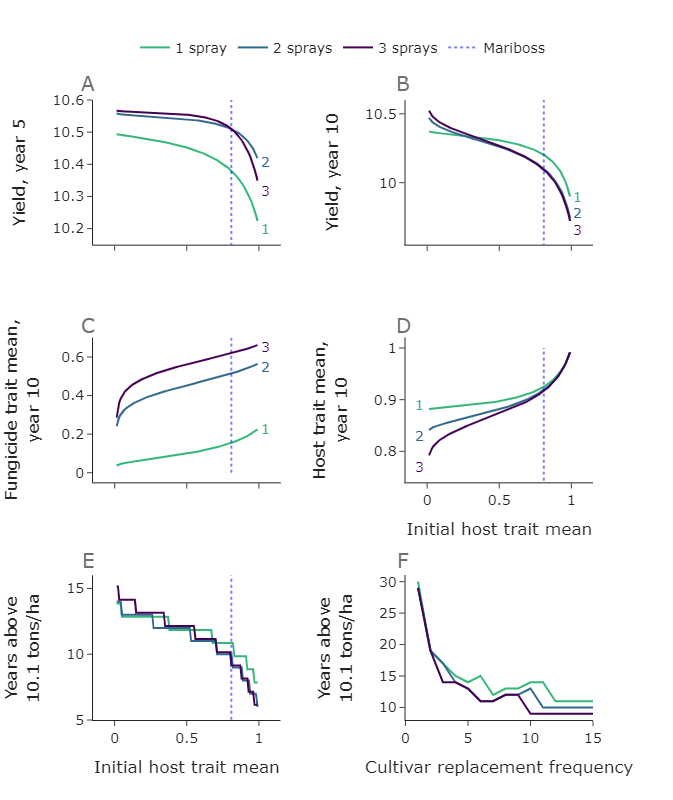

In [268]:
fig = mutual_figure(dfn_use, dfr_use)

fig.show()

In [269]:
fig.write_image('../figures/paper_figs/fig6_draft.png')

## testing

### 1 is best?

In [215]:
def max_by_spray(df):
    
    out = int(df.sort_values(by=['over_th1', 'sprays'], ascending=[False, True]).iloc[0].sprays)

    return out

<AxesSubplot:xlabel='host_mean0'>

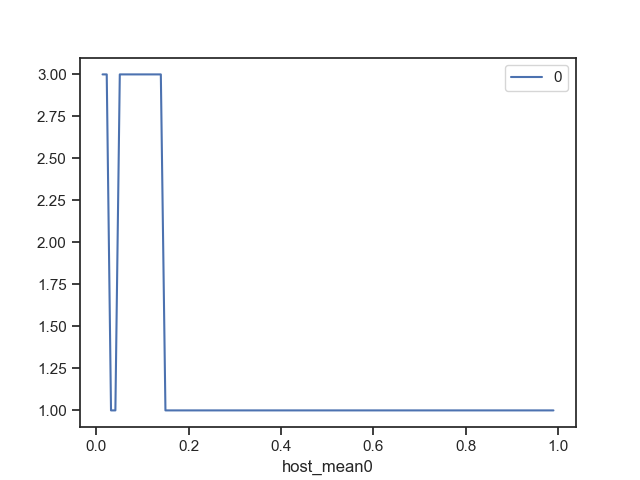

In [223]:
one_best_test = (
    dfn_use
    .loc[:, ['host_mean0', 'sprays', 'over_th1']]
    .groupby('host_mean0').apply(max_by_spray)
    .reset_index()
    .set_index('host_mean0')
)

one_best_test.plot()

In [231]:
(
    one_best_test
    .reset_index()
    .sort_values([0, 'host_mean0'], ascending=[False, True])
    # .head(30)
)

,host_mean0,0
0,0.013815,3
1,0.022885,3
4,0.051175,3
5,0.060852,3
6,0.070611,3
...,...,...
94,0.950000,1
95,0.960000,1
96,0.969998,1
97,0.979985,1


<AxesSubplot:>

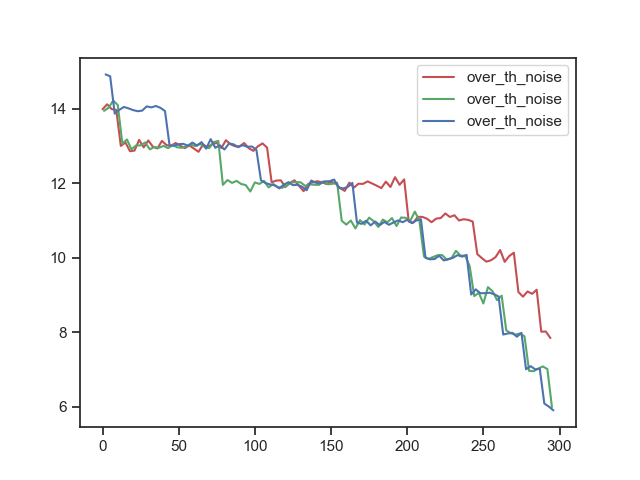

In [249]:
noisy = (
    dfn_use
    .assign(over_th_noise = lambda df: df.over_th1 + np.random.normal(0, 0.08, size=df.shape[0]))
)

f, ax = plt.subplots()

noisy.loc[lambda df: df.sprays==1, ['over_th_noise']].plot(ax=ax, c='r')
noisy.loc[lambda df: df.sprays==2, ['over_th_noise']].plot(ax=ax, c='g')
noisy.loc[lambda df: df.sprays==3, ['over_th_noise']].plot(ax=ax, c='b')

### Testing other stuff

<AxesSubplot:>

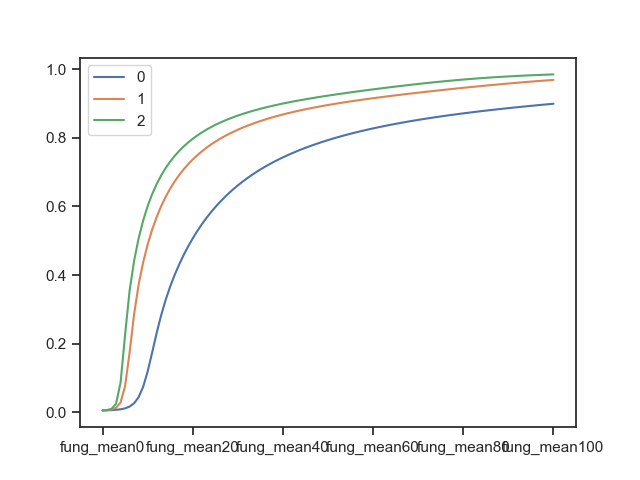

In [232]:
pd.DataFrame(
    dfr_use
    .loc[lambda df: df.repl_n==1]
    # .loc[lambda df: df.sprays==1]
    .filter(like='fung_mean')
    .T
).plot()

In [ ]:
dft = (
    dfn
    .apply(lambda df: years_above_threshold(df, 9.5), axis=1)
    .join(dfn)
)

dft.head(2)

,over_th,host_mean_start,sprays,yld1,yld2,yld3,yld4,yld5,yld6,yld7,...,host_mean41,host_mean42,host_mean43,host_mean44,host_mean45,host_mean46,host_mean47,host_mean48,host_mean49,host_mean50
0,24,0.01,1,10.567713,10.567283,10.562122,10.530375,10.494722,10.46753,10.444276,...,0.992295,0.992567,0.992805,0.993014,0.993198,0.993361,0.993505,0.993633,0.993747,0.993849
1,25,0.01,2,10.567777,10.567687,10.567297,10.565274,10.558721,10.55126,10.545736,...,0.991677,0.992030,0.992337,0.992604,0.992838,0.993044,0.993225,0.993384,0.993526,0.993652


Ok so think we want:

- th = 10, years above threshold
- th = 9.5, years above threshold

- years = 5, yield
- years = 10, yield

- fung mean year 10
- host mean year 10

- th = 10 years above threshold for replacing

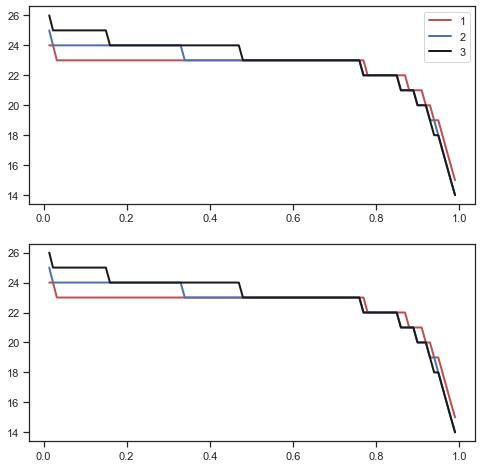

In [348]:
f, ax = plt.subplots(2, 1, figsize=(8,8))

dft1 = dft.loc[lambda df: df.sprays==1]
dft2 = dft.loc[lambda df: df.sprays==2]
dft3 = dft.loc[lambda df: df.sprays==3]

ax[0].plot(dft1.host_mean0, dft1.over_th, label='1', c='r', lw=2)
ax[0].plot(dft2.host_mean0, dft2.over_th, label='2', c='b', lw=2)
ax[0].plot(dft3.host_mean0, dft3.over_th, label='3', c='k', lw=2)

ax[1].plot(dft1.host_mean0, dft1.over_th, label='1', c='r', lw=2)
ax[1].plot(dft2.host_mean0, dft2.over_th, label='2', c='b', lw=2)
ax[1].plot(dft3.host_mean0, dft3.over_th, label='3', c='k', lw=2)

ax[0].legend()

### repl testing

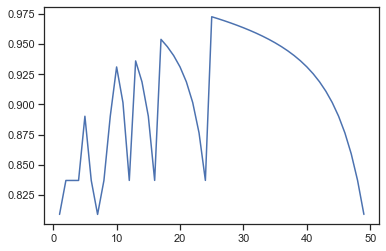

In [435]:
f, ax = plt.subplots()

dfrp = dfr.loc[lambda df: df.sprays==1]

ax.plot(dfrp.repl_n, dfrp.host_mean49)

<AxesSubplot:xlabel='fung_mean49', ylabel='yld49'>

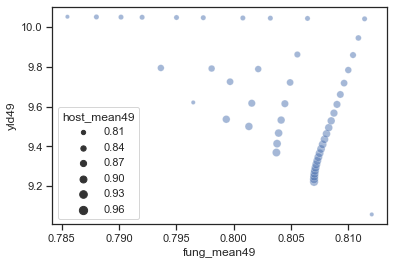

In [451]:
f, ax = plt.subplots()

sns.scatterplot(x=dfrp.fung_mean49, y=dfrp.yld49, size=dfrp.host_mean49, alpha=0.5)

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


<AxesSubplot:xlabel='host_mean50', ylabel='fung_mean50'>

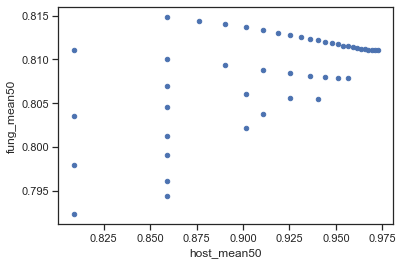

In [476]:
dfrp.loc[lambda df: df.yld50<10, ['host_mean50', 'fung_mean50']].plot.scatter(x='host_mean50', y='fung_mean50')

<AxesSubplot:xlabel='fung_mean49', ylabel='host_mean49'>

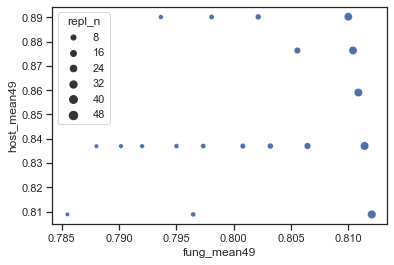

In [484]:
sns.scatterplot(
    x='fung_mean49',
    y='host_mean49',
    # size='yld50',
    size='repl_n',
    data=dfrp.loc[lambda df: df.yld50>9.7]
)

### Yield without fungicide

In [124]:
cs = Config(type='single', 
    sprays=[0], 
    host_on=[True],
    n_years=1,
    mutation_proportion=MUTATION_PROP,
    mutation_scale_fung=DEFAULT_P * FUNG_MUTATION_SCALE,
    mutation_scale_host=DEFAULT_P * HOST_MUTATION_SCALE
)

CONFIG
------
I0_single = 0.0098570319660089
beta_single = 0.0078954305108593
cultivar = Mariboss
host_growth = True
host_on = True
k_b = 0.7310132149416496
k_mu = 10.42015277772923
l_b = 6.519374951898358
l_mu = 0.8089142283850663
mutation_on = True
mutation_proportion = 1.234375e-05
mutation_scale_fung = 0.00191996039181228
mutation_scale_host = 0.00191996039181228
n_iterations = None
n_k = 50
n_l = 50
n_years = 1
replace_cultivars = None
sprays = 0
type = single



In [126]:
from polymodel.run import no_joblib_simulations_run

In [127]:
sol = no_joblib_simulations_run(cs)

running simulation


In [201]:
f"The yield without fungicide input is {sol['spray_N_host_Y']['yield_vec'][0]:.4f}"

'The yield without fungicide input is 9.9644'

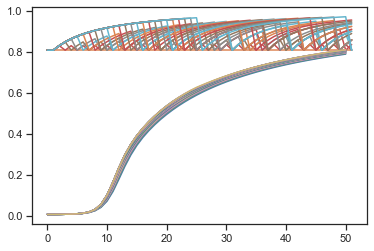

In [ ]:
f, ax = plt.subplots()


for ii in range(25):
    yy = np.array(dfrp.iloc[ii].filter(like='fung_mean'))
    zz = np.array(dfrp.iloc[ii].filter(like='host_mean'))

    ax.plot(yy)
    ax.plot(zz)

# App 1 and 2 figures

See:
- `012_I0` for App 1 figure fitting inoculum
- `015_fung_mutation_fitting` for App 2 figure fitting mutation scale

# App 3 figures

In [64]:
from polymodel.fitting import score_for_this_df

In [65]:
fits = pd.read_csv('../data/05_outputs/app3/app3_fit_combined.csv')

fits

,mu,b,p,loss
0,9.347322,0.871776,0.01,653033.844450
1,10.420153,0.731013,0.10,650344.198374
2,30.650442,0.169459,0.50,682942.775994
3,6.460747,6.720608,0.90,630990.727240


## Fig 2

In [66]:
cont_df = pd.read_csv('../data/03_model_inputs/control_prothio_with_uncertainty.csv')

In [67]:
betas_fit = find_beta_vectorised(
    [0.37]*len(cont_df.year.unique()),
    DEFAULT_I0
)

betas_fit

array([0.00877344, 0.00877344, 0.00877344, 0.00877344, 0.00877344,
       0.00877344, 0.00877344, 0.00877344, 0.00877344, 0.00877344,
       0.00877344, 0.00877344, 0.00877344, 0.00877344, 0.00877344,
       0.00877344, 0.00877344, 0.00877344])

In [68]:
solns = []
NOT_USED = 0.5

for p in [0.01, 0.1, 0.5, 0.9]:
    conf_m = Config(
        type='single',
        n_k=500,
        n_l=10,
        mutation_proportion= MUTATION_PROP,
        mutation_scale_fung= p * FUNG_MUTATION_SCALE,
        mutation_scale_host= p * HOST_MUTATION_SCALE,
        sprays=[1],
        host_on=[False],
        verbose=False
    )
    
    conf_m.k_mu = fits.loc[lambda df: df.p==p].iloc[0].mu
    conf_m.k_b = fits.loc[lambda df: df.p==p].iloc[0].b
    conf_m.l_mu = NOT_USED
    conf_m.l_b = NOT_USED
        
    sol = simulations_run(
        conf_m, 
        I0_vec_run=[DEFAULT_I0]*len(betas_fit),
        beta_vec_run=betas_fit,
    )
    
    ds = sol['spray_Y1_host_N']['dis_sev']
    
    control = 1 - ds / 0.37
    
    solns.append(control)

In [69]:
def app3_fig2(cont_df, solns):
    
    fig = make_subplots(
        rows=2,
        cols=2,
        shared_xaxes=True,
        shared_yaxes=True,
        # horizontal_spacing=0.15,
        # vertical_spacing=0.15,        
    )
    
    col0 = COLZ[0]
    col1 = COLZ[1]
    
    # MARKERS
    scatter_c = go.Scatter(
        x=cont_df.year + np.random.normal(0, 0.05, len(cont_df)), 
        y=cont_df.control_with_noise_t,
        showlegend=False,
        marker=dict(
            color=col0,
            opacity=0.1,
            size=5,
            line=dict(width=1, color='rgba(0,0,0,0.5)')
        ),
        mode='markers'
    )
    
    data = [scatter_c]
    
    fig.add_traces(data, rows=1, cols=1)
    fig.add_traces(data, rows=1, cols=2)
    fig.add_traces(data, rows=2, cols=1)
    fig.add_traces(data, rows=2, cols=2)
    
    
    
    
    
    # LINES
    
    split_year = floor(
        cont_df.year.min() - 1 +
        TRAIN_TEST_SPLIT_PROPORTION * (1 - cont_df.year.min() + cont_df.year.max())
    )
        
    
    for ii, rr, cc in zip(
            [0, 1, 2, 3],
            [1,1,2,2],
            [1,2,1,2],
    ):
        model_df = (
            pd.DataFrame(dict(model=100*solns[ii]))
            .assign(year = np.arange(cont_df.year.min(), 1 + cont_df.year.max()))
        )
            
        model_tr = model_df.loc[lambda df: df.year<=split_year]
        model_te = model_df.loc[lambda df: df.year>=split_year]
        
        
        lines = [
            go.Scatter(
                x = model_tr.year,
                y = model_tr.model,
                line=dict(color=col1, width=4, dash='solid'),
                mode='lines',
                name=ii,
            ),
            go.Scatter(
                x = model_te.year,
                y = model_te.model,
                line=dict(color=col1, width=4, dash='dot'),
                mode='lines'
            ),
        ]
            
        fig.add_traces(lines, rows=rr, cols=cc)
    
    
    col_1 = -0.03
    col_2 = 0.53
    
    row1 = 1.06
    row2 = 0.48

    annotz = [
            
        get_text_annotation(col_1, row1, 'A: 1%', size=20, xanchor='left'),
        get_text_annotation(col_2, row1, 'B: 10%', size=20, xanchor='left'),
        get_text_annotation(col_1, row2, 'C: 50%', size=20, xanchor='left'),
        get_text_annotation(col_2, row2, 'D: 90%', size=20, xanchor='left'),
        
    ]

    fig.update_layout(annotations=annotz)
    
    fig.update_layout(standard_layout(False, height=750))
    fig.update_layout(font=dict(size=14))
    
    fig.update_xaxes(title_text='Year',
                     row=2,
                     col=1,
                     # range=[-0.01, 1.01],
                     showgrid=False)
    
    fig.update_xaxes(title_text='Year',
                     row=2,
                     col=2,
                     # range=[-0.01, 1.01],
                     showgrid=False)
    
    fig.update_yaxes(title_text='Model fit score',
                     row=1,
                     col=1,
                     showgrid=False)
    
    fig.update_yaxes(title_text='Model fit score',
                     row=2,
                     col=1,
                     showgrid=False)
    
    
    return fig

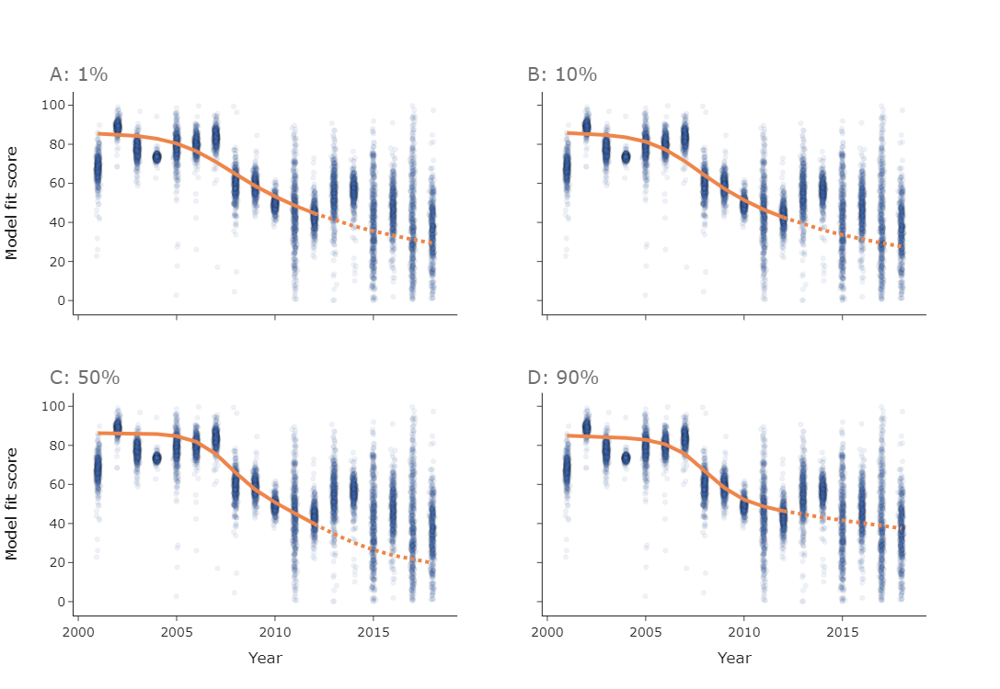

In [70]:
fig2 = app3_fig2(cont_df, solns)
fig2.show()

In [71]:
fig2.write_image('../figures/paper_figs/app3_fig2.png')

## Fig 1

Relies on `solns` from fig 2

In [72]:
cont_df_use = (
    cont_df
    .rename(columns = {'control_with_noise_t': 'data_control'})
    .loc[lambda df: df.year>=2013, ['year', 'data_control']]
)

In [84]:
cont_df.loc[lambda df: df.year<=2012]

,Unnamed: 0,year,RD,RDU,k,kU,R2,RDnoise,thisRD,knoise,thisK,control,control_with_noise,yearnoise,knoiset,RDnoiset,thisRDt,thisKt,control_with_noise_t
0,0,2001,0.760,0.033,2.32,0.29,0.99,0.058214,0.818214,0.001744,2.321744,68.531207,73.794505,2000.960789,-0.045642,-0.033148,0.726852,2.274358,65.208590
1,1,2001,0.760,0.033,2.32,0.29,0.99,0.013205,0.773205,0.218304,2.538304,68.531207,71.212175,2001.037995,0.001437,-0.005557,0.754443,2.321437,68.040734
2,2,2001,0.760,0.033,2.32,0.29,0.99,0.032298,0.792298,0.067408,2.387408,68.531207,71.951187,2000.978314,0.253695,-0.013926,0.746074,2.573695,68.918310
3,3,2001,0.760,0.033,2.32,0.29,0.99,0.073949,0.833949,0.171535,2.491535,68.531207,76.491281,2000.871846,-0.405816,-0.037936,0.722064,1.914184,61.558706
4,4,2001,0.760,0.033,2.32,0.29,0.99,0.061629,0.821629,-0.296132,2.023868,68.531207,71.305657,2000.944418,0.541304,-0.009728,0.750272,2.861304,70.736121
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
5995,5995,2012,0.512,0.032,1.92,0.31,0.98,-0.002125,0.509875,-0.523986,1.396014,43.693724,38.363908,2012.142520,0.176590,0.013137,0.525137,2.096590,46.061122
5996,5996,2012,0.512,0.032,1.92,0.31,0.98,-0.020248,0.491752,-0.295731,1.624269,43.693724,39.484987,2011.953755,-0.904763,0.023423,0.535423,1.015237,34.143054
5997,5997,2012,0.512,0.032,1.92,0.31,0.98,-0.005565,0.506435,-0.647755,1.272245,43.693724,36.453063,2012.024945,0.022914,-0.039063,0.472937,1.942914,40.517223
5998,5998,2012,0.512,0.032,1.92,0.31,0.98,-0.026426,0.485574,0.146514,2.066514,43.693724,42.408740,2012.080234,-0.569557,0.008680,0.520680,1.350443,38.575889


In [73]:
solns[ii][-6:]

array([0.44634389, 0.43077472, 0.41618921, 0.40217849, 0.38854961,
       0.37517332])

In [86]:
scores = []

for ii in range(4):
    scores.append(score_for_this_df(cont_df_use, 100*solns[ii][-6:]))

test_scores = (
    pd.DataFrame(dict(
        p=[0.01, 0.1, 0.5, 0.9],
        scores=scores
    ))
    .assign(mean_score = lambda df: df.scores/3000)
)

test_scores

,p,scores,mean_score
0,0.01,1.081703e+06,360.567810
1,0.10,1.218480e+06,406.160129
2,0.50,1.866008e+06,622.002523
3,0.90,8.258344e+05,275.278149


In [87]:
fits_use = fits.assign(mean_score=lambda df: df.loss/6000)

In [88]:
fits_use

,mu,b,p,loss,mean_score
0,9.347322,0.871776,0.01,653033.844450,108.838974
1,10.420153,0.731013,0.10,650344.198374,108.390700
2,30.650442,0.169459,0.50,682942.775994,113.823796
3,6.460747,6.720608,0.90,630990.727240,105.165121


In [94]:
def app3_fig1(fits, test_scores):
    
    col = COLZ[1]
    
    fig = make_subplots(
        rows=2,
        cols=1,
        shared_xaxes=True,
        # shared_yaxes=True,
        # horizontal_spacing=0.15,
        # vertical_spacing=0.15,        
    )
    
    data1 = [go.Scatter(
        x=fits.p,
        y=fits.mean_score, 
        line=dict(color=col)
    )]
    
    data2 = [go.Scatter(
        x=test_scores.p,
        y=test_scores.mean_score, 
        line=dict(color=col)
    )]
    
    fig.add_traces(data1, rows=1, cols=1)
    fig.add_traces(data2, rows=2, cols=1)
    fig.update_layout(standard_layout(False, height=600))
    fig.update_layout(font=dict(size=14))
    
    col_1 = -0.02
    
    row1 = 1.07
    row2 = 0.50

    annotz = [
            
        get_text_annotation(col_1, row1, 'A', size=20, xanchor='left'),
        get_text_annotation(col_1, row2, 'B', size=20, xanchor='left'),
        
    ]

    fig.update_layout(annotations=annotz)
    
    fig.update_xaxes(title_text='Proportion of maximum mutation scale',
                     range=[-0.01, 1.01],
                     row=2,
                     col=1,
                     showgrid=False)
    
    fig.update_yaxes(title_text='Model training score',
                     row=1,
                     col=1,
                     # range=[-0.01, 1.01],
                     showgrid=False)
    
    fig.update_yaxes(title_text='Model test score',
                     row=2,
                     col=1,
                     # range=[-0.01, 1.01],
                     showgrid=False)
    
    
    return fig

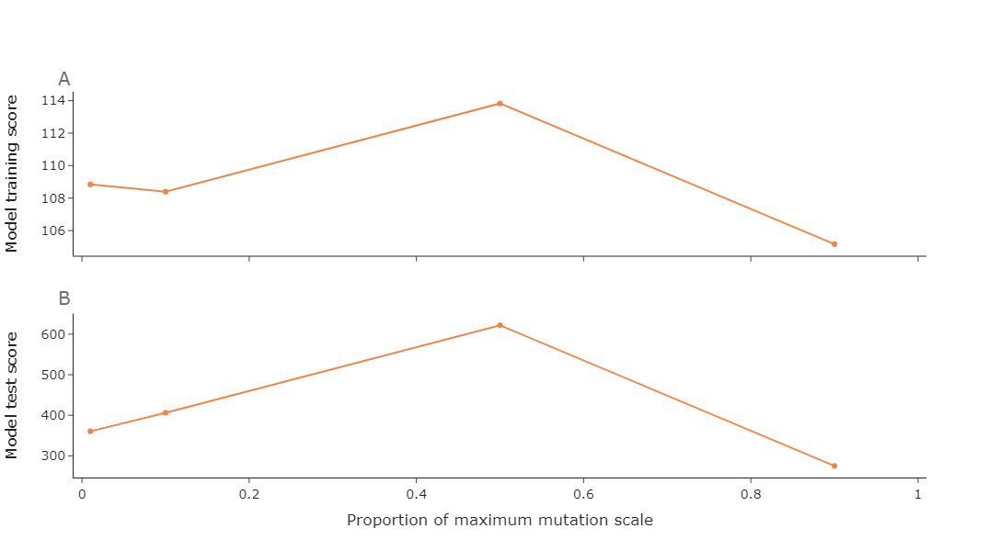

In [95]:
f1 = app3_fig1(fits_use, test_scores)

f1.show()

In [96]:
f1.write_image('../figures/paper_figs/app3_fig1.png')

## Fig 3

In [78]:
def get_soln_app3_fig3(p):
    
    conf = Config(
        type='single',
        n_k=500,
        n_l=10,
        mutation_proportion= MUTATION_PROP,
        mutation_scale_fung= p * FUNG_MUTATION_SCALE,
        mutation_scale_host= p * HOST_MUTATION_SCALE,
        sprays=[1, 2, 3],
        host_on=[False]
    )
    
    conf.k_mu = fits.loc[lambda df: df.p==p].iloc[0].mu
    conf.k_b = fits.loc[lambda df: df.p==p].iloc[0].b
    conf.l_mu = NOT_USED
    conf.l_b = NOT_USED
        
    sol = simulations_run(
        conf,
        I0_vec_run=[DEFAULT_I0]*15,
        beta_vec_run=[DEFAULT_BETA]*15,
    )
    
    return sol

In [79]:
solnsA = get_soln_app3_fig3(0.01)
solnsB = get_soln_app3_fig3(0.1)
solnsC = get_soln_app3_fig3(0.5)
solnsD = get_soln_app3_fig3(0.9)

CONFIG
------
I0_single = 0.0098570319660089
beta_single = 0.0078954305108593
cultivar = Mariboss
host_growth = True
host_on = False
k_b = None
k_mu = None
l_b = None
l_mu = None
mutation_on = True
mutation_proportion = 1.234375e-05
mutation_scale_fung = 0.000191996039181228
mutation_scale_host = 0.000191996039181228
n_iterations = None
n_k = 500
n_l = 10
n_years = 25
replace_cultivars = None
sprays = 1, 2, 3
type = single

CONFIG
------
I0_single = 0.0098570319660089
beta_single = 0.0078954305108593
cultivar = Mariboss
host_growth = True
host_on = False
k_b = 0.7310132149416496
k_mu = 10.42015277772923
l_b = 6.519374951898358
l_mu = 0.8089142283850663
mutation_on = True
mutation_proportion = 1.234375e-05
mutation_scale_fung = 0.00191996039181228
mutation_scale_host = 0.00191996039181228
n_iterations = None
n_k = 500
n_l = 10
n_years = 25
replace_cultivars = None
sprays = 1, 2, 3
type = single

CONFIG
------
I0_single = 0.0098570319660089
beta_single = 0.0078954305108593
cultivar = Mar

In [80]:
def app3_fig3(solnsA, solnsB, solnsC, solnsD):
    
    fig = make_subplots(
        rows=2,
        cols=2,
        shared_xaxes=True,
        shared_yaxes=True,
        # horizontal_spacing=0.15,
        # vertical_spacing=0.15,        
    )
    
    cols = px.colors.sequential.Viridis
    col0 = 'rgb(0.5,0.5,0.5)'
    col1 = cols[6]
    col2 = cols[3]
    col3 = cols[0]
    
    
    # LINES
    
    split_year = floor(
        cont_df.year.min() - 1 +
        TRAIN_TEST_SPLIT_PROPORTION * (1 - cont_df.year.min() + cont_df.year.max())
    )
        
    
    for sol, rr, cc, showledge in zip(
            [solnsA, solnsB, solnsC, solnsD],
            [1,1,2,2],
            [1,2,1,2],
            [True] + [False]*3,
    ):
        
        sev1 = sol['spray_Y1_host_N']['dis_sev']
        sev2 = sol['spray_Y2_host_N']['dis_sev']
        sev3 = sol['spray_Y3_host_N']['dis_sev']
          
        lines = [
            go.Scatter(
                x = np.arange(1, len(sev1)+1),
                y = 100*sev1,
                line=dict(color=col1, dash='dashdot'),
                name='1 spray',
                mode='lines',
                showlegend=showledge
            ),
            go.Scatter(
                x = np.arange(1, len(sev2)+1),
                y = 100*sev2,
                line=dict(color=col2, dash='dash'),
                name='2 sprays',
                mode='lines',
                showlegend=showledge
            ),
            go.Scatter(
                x = np.arange(1, len(sev3)+1),
                y = 100*sev3,
                line=dict(color=col3),
                name='3 sprays',
                mode='lines',
                showlegend=showledge
            ),
        ]
            
        fig.add_traces(lines, rows=rr, cols=cc)
    
    
    col_1 = -0.03
    col_2 = 0.53
    
    row1 = 1.07
    row2 = 0.49

    annotz = [
            
        get_text_annotation(col_1, row1, 'A: 1%', size=20, xanchor='left'),
        get_text_annotation(col_2, row1, 'B: 10%', size=20, xanchor='left'),
        get_text_annotation(col_1, row2, 'C: 50%', size=20, xanchor='left'),
        get_text_annotation(col_2, row2, 'D: 90%', size=20, xanchor='left'),
        
    ]

    fig.update_layout(annotations=annotz)
    
    fig.update_layout(standard_layout(True, height=750))
    fig.update_layout(font=dict(size=14))
    fig.update_layout(legend=dict(
        x=0.5,
        y=1.15,
        xanchor='center',
        orientation='h'
    ))
                                  
    
    fig.update_xaxes(title_text='Year',
                     row=2,
                     col=1,
                     range=[0, 15.5],
                     showgrid=False)
    
    fig.update_xaxes(title_text='Year',
                     row=2,
                     col=2,
                     range=[0, 15.5],
                     showgrid=False)
    
    sev_range = [-1, 15]
    fig.update_yaxes(title_text='Disease severity',
                     row=1,
                     col=1,
                     range=sev_range,
                     showgrid=False)
    
    fig.update_yaxes(title_text='Disease severity',
                     row=2,
                     col=1,
                     range=sev_range,
                     showgrid=False)
    
    
    return fig

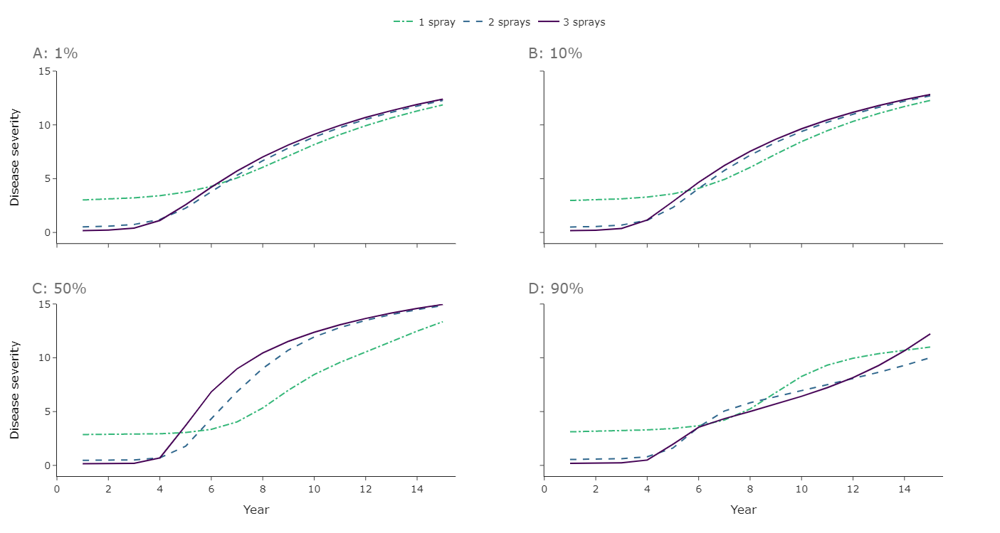

In [81]:
fig3 = app3_fig3(solnsA, solnsB, solnsC, solnsD)
fig3.show()

In [82]:
fig3.write_image('../figures/paper_figs/app3_fig3.png')

### Exploring p = 0.9

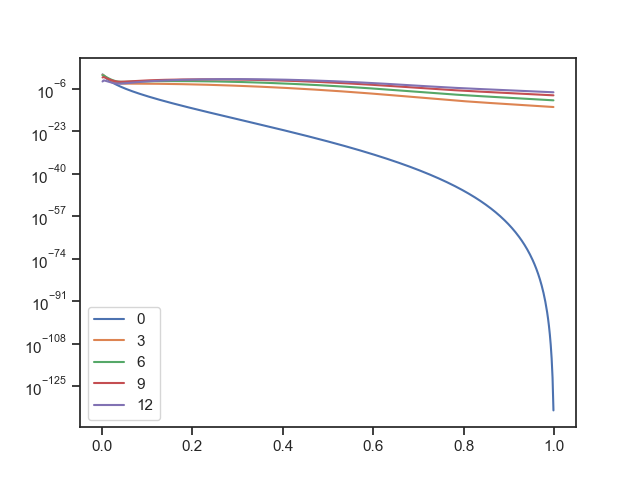

In [415]:
f, ax = plt.subplots()

for i in range(0, 15, 3):
    ax.plot(
        solnsD['spray_Y1_host_N']['k_vec'],
        solnsD['spray_Y1_host_N']['fung_dists'][:, i],
        label=str(i),
    )

ax.set_yscale('log')

ax.legend()

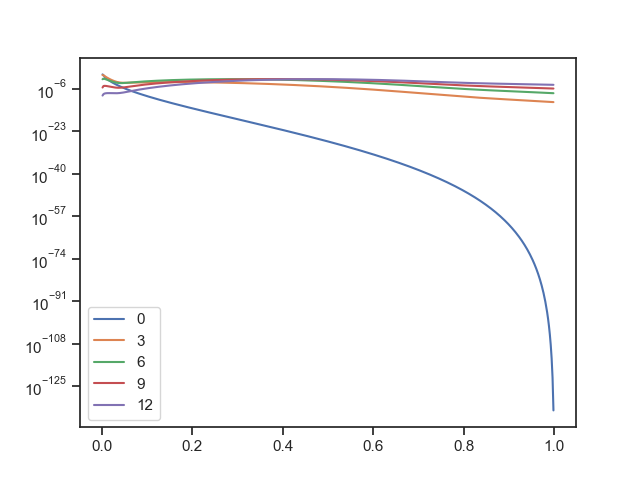

In [416]:
f, ax = plt.subplots()

for i in range(0, 15, 3):
    ax.plot(
        solnsD['spray_Y2_host_N']['k_vec'],
        solnsD['spray_Y2_host_N']['fung_dists'][:, i],
        label=str(i),
    )

ax.set_yscale('log')

ax.legend()

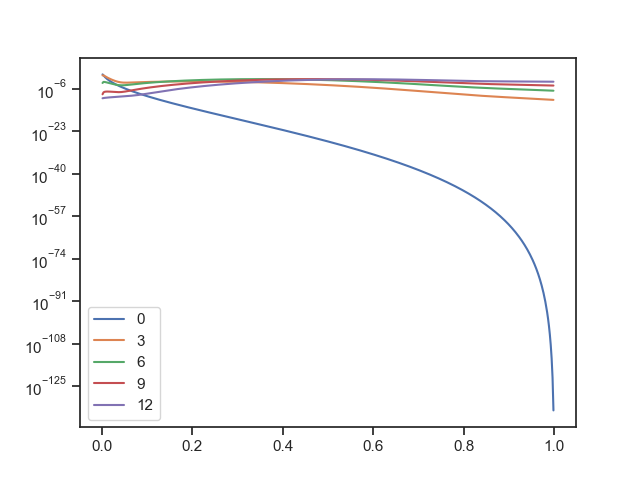

In [417]:
f, ax = plt.subplots()

for i in range(0, 15, 3):
    ax.plot(
        solnsD['spray_Y3_host_N']['k_vec'],
        solnsD['spray_Y3_host_N']['fung_dists'][:, i],
        label=str(i),
    )

ax.set_yscale('log')

ax.legend()

(0.001, 1)

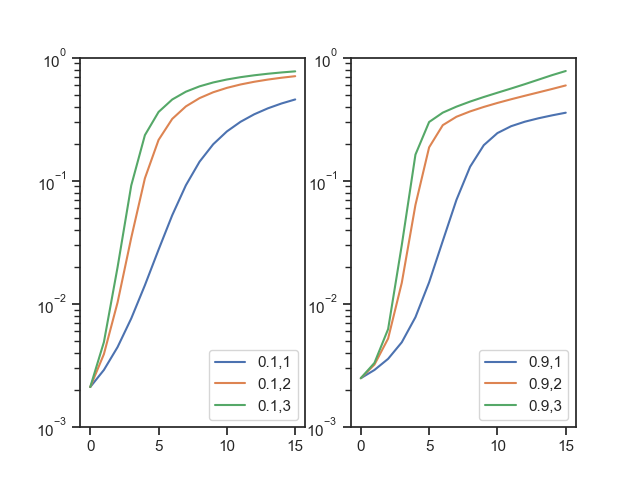

In [427]:
f, ax = plt.subplots(1, 2)


for i in [1, 2, 3]:
    kB = solnsB[f'spray_Y{i}_host_N']['k_vec']
    dB = solnsB[f'spray_Y{i}_host_N']['fung_dists']
    dtB = generate_dist_mean(dB, kB)

    ax[0].plot(dtB, label=str(0.1) + ',' + str(i))

    kD = solnsD[f'spray_Y{i}_host_N']['k_vec']
    dD = solnsD[f'spray_Y{i}_host_N']['fung_dists']
    dtD = generate_dist_mean(dD, kD)

    ax[1].plot(dtD, label=str(0.9) + ',' + str(i))


ax[0].set_yscale('log')
ax[1].set_yscale('log')

ax[0].legend()
ax[1].legend()

ax[0].set_ylim([1e-3, 1])
ax[1].set_ylim([1e-3, 1])

(1e-10, 0.01)

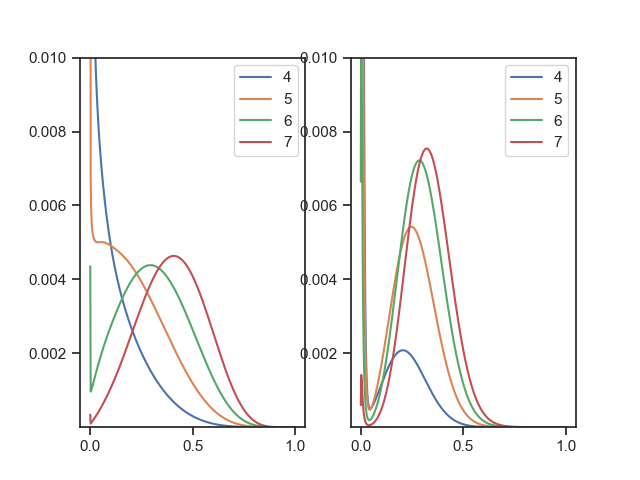

In [447]:
f, ax = plt.subplots(1, 2)

for i in range(4, 8):
    
    ax[0].plot(
        solnsB['spray_Y2_host_N']['k_vec'],
        solnsB['spray_Y2_host_N']['fung_dists'][:, i],
        label=str(i),
    )
    
    ax[1].plot(
        solnsD['spray_Y2_host_N']['k_vec'],
        solnsD['spray_Y2_host_N']['fung_dists'][:, i],
        label=str(i),
    )

# ax[0].set_yscale('log')
# ax[1].set_yscale('log')
# ax[0].set_ylim([1e-10, 1])
# ax[1].set_ylim([1e-10, 1])

ax[0].legend()
ax[1].legend()

ax[0].set_ylim([1e-10, 1e-2])
ax[1].set_ylim([1e-10, 1e-2])

Ok so here we have 2 sprays, 0.1 vs 0.9.

0.9 has shape parameter 6.7 vs 0.1 shape param 0.73. This means has smaller variance, think mutation gets away from mu=0 initially and then small variance means it then slows down.

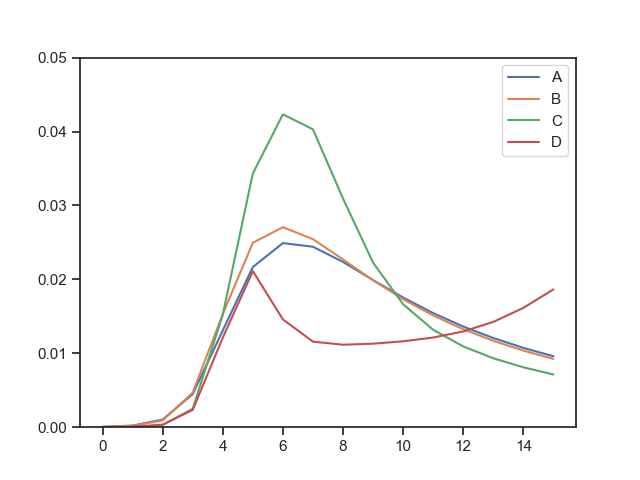

In [445]:
f, ax = plt.subplots()

ax.plot(generate_dist_var(
    solnsA['spray_Y2_host_N']['fung_dists'],
    solnsA['spray_Y2_host_N']['k_vec']),
    label='A'
)

ax.plot(generate_dist_var(
    solnsB['spray_Y2_host_N']['fung_dists'],
    solnsB['spray_Y2_host_N']['k_vec']),
    label='B'
)

ax.plot(generate_dist_var(
    solnsC['spray_Y2_host_N']['fung_dists'],
    solnsC['spray_Y2_host_N']['k_vec']
    ),
    label='C'
)

ax.plot(
    generate_dist_var(
        solnsD['spray_Y2_host_N']['fung_dists'],
        solnsD['spray_Y2_host_N']['k_vec']
    ), 
    label='D'
)

ax.set_ylim([1e-20, 5e-2])

ax.legend()